In [1]:
import pandas as pd
import numpy as np
import math

In [82]:
experiments = 5
epochs = 100

activations = ['selu', 'sigmoid']
optimizers = ['Adamax', 'sgd']

# colors_new = ['b', 'g', 'k', 'y', 'm', 'r', 'c']
colors = ['#000000', '#330000', '#660000', '#990000', '#CC0000', '#FF0000',
          '#003300', '#006600', '#009900', '#00CC00', '#00FF00',
          '#000033', '#000066', '#000099', '#0000CC', '#0000FF',
          '#033000', '#066000', '#099000', '#0CC000', '#0FF000',
          '#000330', '#000660', '#000990', '#000CC0', '#000FF0']
colors_new = ['#FF0000', '#FF8000', '#00AA00', '#0000FF', '#7F00FF', 'k', '#000000']
colors_opt = ['#FF0000', '#FF8000', '#00AA00', '#0000FF', '#7F00FF', 'k', 'y', 'm', 'c', '#CC0066', '#000000']
lines = ['-', '--', ':', '-.']
cols_f = []
for c in colors:
    for l in lines:
        cols_f.append(c+l)
columns=['epoch', 'acc', 'loss', 'val_acc', 'val_loss']

In [83]:
def load_data(path, activations, optimizers, experiments, units):
    data = []
    i = 0
    for act in activations:
        for opt in optimizers:
            data.append({
                'name': 'Activation: ' + act + ', optimizer: ' + opt,
                'disp_name': act + '_' + opt,
                'col': colors[i % len(colors)],
                'line': lines[i % len(lines)],
                'act': act,
                'opt':opt,
                'data' : [pd.read_csv(path + act +'_' + opt + '_' + str(ex)  + '_' + str(units) + '.csv') for ex in range(experiments)],
                'max_val_acc':{},

            })
            
    for d in range(len(data)):
        data[d]['averaged'] = pd.DataFrame(columns=['epoch', 'val_acc'])
        for epoch in range(epochs):
            val_acc = []

            for experiment in range(experiments):
                val_acc.append(data[d]['data'][experiment].iloc[epoch]['val_acc'])

                if epoch == 0:
                    data[d]['max_val_acc'][experiment] = {}
                    data[d]['max_val_acc'][experiment]['val_acc'] = data[d]['data'][experiment].iloc[epoch]['val_acc']
                    data[d]['max_val_acc'][experiment]['epoch'] = epoch
                    data[d]['max_val_acc']['upper_max'] = {}
                    data[d]['max_val_acc']['upper_max']['val_acc'] = data[d]['data'][experiment].iloc[epoch]['val_acc']
                    data[d]['max_val_acc']['upper_max']['epoch'] = epoch
                else:
                    if data[d]['max_val_acc'][experiment]['val_acc'] < data[d]['data'][experiment].iloc[epoch]['val_acc']:
                        data[d]['max_val_acc'][experiment]['val_acc'] = data[d]['data'][experiment].iloc[epoch]['val_acc']
                        data[d]['max_val_acc'][experiment]['epoch'] = epoch
                    if data[d]['data'][experiment].iloc[epoch]['val_acc'] > data[d]['max_val_acc']['upper_max']['val_acc']:
                        data[d]['max_val_acc']['upper_max']['val_acc'] = data[d]['data'][experiment].iloc[epoch]['val_acc']
                        data[d]['max_val_acc']['upper_max']['epoch'] = epoch


            av_val_acc = sum(val_acc)/len(val_acc)

            if epoch == 0:
                data[d]['max_val_acc']['avg'] = {}
                data[d]['max_val_acc']['avg']['val_acc'] = av_val_acc
                data[d]['max_val_acc']['avg']['epoch'] = epoch
            else:
                if(av_val_acc >= data[d]['max_val_acc']['avg']['val_acc']):
                    data[d]['max_val_acc']['avg']['val_acc'] = av_val_acc
                    data[d]['max_val_acc']['avg']['epoch'] = epoch

            data[d]['averaged'] = data[d]['averaged'].append({
                'epoch': epoch,
                'val_acc': av_val_acc
            }, ignore_index=True)
            
        data[d]['max_val_acc']['last_max'] = max([data[d]['data'][experiment]['val_acc'].tolist()[-1] for experiment in range(experiments)])
    
    return data

In [84]:
data_035 = load_data('./logs/training_logs/mnist_lr_0.35_', activations, optimizers, experiments, 64)
data_05 = load_data('./logs/training_logs/mnist_lr_0.5_', activations, optimizers, experiments, 64)
data_02 = load_data('./logs/training_logs/mnist_lr_', activations, optimizers, experiments, 64)
data_fx = load_data('../01_mlp_act_opt/logs/training_logs/mnist_', activations, optimizers, experiments, 64)

In [85]:
check_035 = pd.DataFrame(columns=['config', 'exp', 'acc', 'loss', 'val_acc', 'val_loss', 'opt', 'act'])
i=0
for d in range(len(data_035)):
    for experiment in range(experiments):
        check_035.loc[i] = [data_035[d]['disp_name'], 
                          experiment,
                          data_035[d]['data'][experiment]['acc'].tolist()[-1], 
                          data_035[d]['data'][experiment]['loss'].tolist()[-1], 
                          data_035[d]['data'][experiment]['val_acc'].tolist()[-1], 
                          data_035[d]['data'][experiment]['val_loss'].tolist()[-1], 
                          data_035[d]['opt'], 
                          data_035[d]['act']]
        i+=1


In [86]:
check_035 = check_035.sort_values(by=['val_acc'])
check_035

,config,exp,acc,loss,val_acc,val_loss,opt,act
116,linear_sgd,1,0.915183,0.303633,0.9218,0.269044,sgd,linear
117,linear_sgd,2,0.915100,0.302603,0.9222,0.270338,sgd,linear
119,linear_sgd,4,0.916017,0.298697,0.9225,0.268495,sgd,linear
118,linear_sgd,3,0.920367,0.285281,0.9243,0.267654,sgd,linear
115,linear_sgd,0,0.920833,0.283283,0.9254,0.267302,sgd,linear
123,linear_Adagrad,3,0.921733,0.285197,0.9255,0.264806,Adagrad,linear
134,linear_Adamax,4,0.926400,0.266719,0.9258,0.266654,Adamax,linear
125,linear_Adadelta,0,0.926700,0.269912,0.9259,0.266096,Adadelta,linear
129,linear_Adadelta,4,0.926600,0.267703,0.9259,0.265897,Adadelta,linear
121,linear_Adagrad,1,0.920950,0.282583,0.9259,0.263943,Adagrad,linear


In [87]:
results = pd.DataFrame(columns=['opt', 'act', 'val_acc', 'max_avg_val_acc', 'max_avg_val_acc_epoch', 'upper_max_val_acc', 'upper_max_val_acc_epoch'])
i=0
for d in data_035:
    results.loc[i] = [
        d['opt'], 
        d['act'],
        d['averaged']['val_acc'].tolist()[-1], 
        d['max_val_acc']['avg']['val_acc'],
        d['max_val_acc']['avg']['epoch'],
        d['max_val_acc']['upper_max']['val_acc'],
        d['max_val_acc']['upper_max']['epoch']
    ]
    i+=1
results.head()

,opt,act,val_acc,max_avg_val_acc,max_avg_val_acc_epoch,upper_max_val_acc,upper_max_val_acc_epoch
0,rmsp,sigmoid,0.97482,0.97500,70,0.9767,55
1,adam,sigmoid,0.97596,0.97630,47,0.9779,55
2,sgd,sigmoid,0.93540,0.93540,99,0.9364,99
3,Adagrad,sigmoid,0.96072,0.96078,95,0.9632,99
4,Adadelta,sigmoid,0.97674,0.97682,89,0.9783,85


In [88]:
results = pd.DataFrame(columns=['opt', 'act', 
                                'Fixed LR: Last Average val_acc', 
                                'ReduceLR (0.2): Last Average val_acc', 
                                'ReduceLR (0.5): Last Average val_acc', 
                                'ReduceLR (0.35): Last Average val_acc', 
                                'Last Average val_acc Diff (0.2 - Fix)',
                                'Last Average val_acc Diff (0.5 - Fix)',
                                'Last Average val_acc Diff (0.35 - Fix)',
                                'Fixed LR: Max Average val_acc',
                                'ReduceLR (0.2): Max Average val_acc',
                                'ReduceLR (0.5): Max Average val_acc',
                                'ReduceLR (0.35): Max Average val_acc',
                                'Max Average val_acc Diff (0.2 - Fix)',
                                'Max Average val_acc Diff (0.5 - Fix)',
                                'Max Average val_acc Diff (0.35 - Fix)',
                                'Fixed LR: Max Avg val_acc Epoch',
                                'ReduceLR (0.2): Max Avg val_acc Epoch',
                                'ReduceLR (0.5): Max Avg val_acc Epoch',
                                'ReduceLR (0.35): Max Avg val_acc Epoch',
                                'Fixed LR: Max Last val_acc',
                                'ReduceLR (0.2): Max Last val_acc',
                                'ReduceLR (0.5): Max Last val_acc',
                                'ReduceLR (0.35): Max Last val_acc',
                                'Max Last val_acc Diff (0.2 - Fix)',
                                'Max Last val_acc Diff (0.5 - Fix)',
                                'Max Last val_acc Diff (0.35 - Fix)',
                                'Fixed LR: Max Achieved val_acc',
                                'ReduceLR (0.2): Max Achieved val_acc',
                                'ReduceLR (0.5): Max Achieved val_acc',
                                'ReduceLR (0.35): Max Achieved val_acc',
                                'Max Achieved val_acc Diff (0.2 - Fix)',
                                'Max Achieved val_acc Diff (0.5 - Fix)',
                                'Max Achieved val_acc Diff (0.35 - Fix)'
                               ])

for i in range(len(data_fx)):
    results.loc[i] = [
        data_fx[i]['opt'], 
        data_fx[i]['act'],
        data_fx[i]['averaged']['val_acc'].tolist()[-1] * 100, 
        data_02[i]['averaged']['val_acc'].tolist()[-1] * 100,
        data_05[i]['averaged']['val_acc'].tolist()[-1] * 100,
        data_035[i]['averaged']['val_acc'].tolist()[-1] * 100,
        data_02[i]['averaged']['val_acc'].tolist()[-1] * 100 - data_fx[i]['averaged']['val_acc'].tolist()[-1] * 100,
        data_05[i]['averaged']['val_acc'].tolist()[-1] * 100 - data_fx[i]['averaged']['val_acc'].tolist()[-1] * 100,
        data_035[i]['averaged']['val_acc'].tolist()[-1] * 100 - data_fx[i]['averaged']['val_acc'].tolist()[-1] * 100,
        data_fx[i]['max_val_acc']['avg']['val_acc'] * 100,
        data_02[i]['max_val_acc']['avg']['val_acc'] * 100,
        data_05[i]['max_val_acc']['avg']['val_acc'] * 100,
        data_035[i]['max_val_acc']['avg']['val_acc'] * 100,
        data_02[i]['max_val_acc']['avg']['val_acc'] * 100 - data_fx[i]['max_val_acc']['avg']['val_acc'] * 100,
        data_05[i]['max_val_acc']['avg']['val_acc'] * 100 - data_fx[i]['max_val_acc']['avg']['val_acc'] * 100,
        data_035[i]['max_val_acc']['avg']['val_acc'] * 100 - data_fx[i]['max_val_acc']['avg']['val_acc'] * 100,
        data_fx[i]['max_val_acc']['avg']['epoch'],
        data_02[i]['max_val_acc']['avg']['epoch'],
        data_05[i]['max_val_acc']['avg']['epoch'],
        data_035[i]['max_val_acc']['avg']['epoch'],
        data_fx[i]['max_val_acc']['last_max'] * 100,
        data_02[i]['max_val_acc']['last_max'] * 100,
        data_05[i]['max_val_acc']['last_max'] * 100,
        data_035[i]['max_val_acc']['last_max'] * 100,
        data_02[i]['max_val_acc']['last_max'] * 100 - data_fx[i]['max_val_acc']['last_max'] * 100,
        data_05[i]['max_val_acc']['last_max'] * 100 - data_fx[i]['max_val_acc']['last_max'] * 100,
        data_035[i]['max_val_acc']['last_max'] * 100 - data_fx[i]['max_val_acc']['last_max'] * 100,
        data_fx[i]['max_val_acc']['upper_max']['val_acc'] * 100,
        data_02[i]['max_val_acc']['upper_max']['val_acc'] * 100,
        data_05[i]['max_val_acc']['upper_max']['val_acc'] * 100,
        data_035[i]['max_val_acc']['upper_max']['val_acc'] * 100,
        data_02[i]['max_val_acc']['upper_max']['val_acc'] * 100 - data_fx[i]['max_val_acc']['upper_max']['val_acc'] * 100,
        data_05[i]['max_val_acc']['upper_max']['val_acc'] * 100 - data_fx[i]['max_val_acc']['upper_max']['val_acc'] * 100,
        data_035[i]['max_val_acc']['upper_max']['val_acc'] * 100 - data_fx[i]['max_val_acc']['upper_max']['val_acc'] * 100
    ]
    i+=1
results

,opt,act,Fixed LR: Last Average val_acc,ReduceLR (0.2): Last Average val_acc,ReduceLR (0.5): Last Average val_acc,ReduceLR (0.35): Last Average val_acc,Last Average val_acc Diff (0.2 - Fix),Last Average val_acc Diff (0.5 - Fix),Last Average val_acc Diff (0.35 - Fix),Fixed LR: Max Average val_acc,...,Max Last val_acc Diff (0.2 - Fix),Max Last val_acc Diff (0.5 - Fix),Max Last val_acc Diff (0.35 - Fix),Fixed LR: Max Achieved val_acc,ReduceLR (0.2): Max Achieved val_acc,ReduceLR (0.5): Max Achieved val_acc,ReduceLR (0.35): Max Achieved val_acc,Max Achieved val_acc Diff (0.2 - Fix),Max Achieved val_acc Diff (0.5 - Fix),Max Achieved val_acc Diff (0.35 - Fix)
0,rmsp,sigmoid,97.536,97.438,97.560,97.482,-0.098,0.024,-0.054,97.624,...,-0.07,0.08,-0.05,97.77,97.65,97.69,97.67,-0.12,-0.08,-0.10
1,adam,sigmoid,97.500,97.604,97.592,97.596,0.104,0.092,0.096,97.584,...,0.07,0.04,0.09,97.73,97.77,97.79,97.79,0.04,0.06,0.06
2,sgd,sigmoid,93.542,93.634,93.474,93.540,0.092,-0.068,-0.002,93.542,...,0.19,0.02,-0.02,93.66,93.85,93.68,93.64,0.19,0.02,-0.02
3,Adagrad,sigmoid,96.060,95.992,96.200,96.072,-0.068,0.140,0.012,96.060,...,-0.03,0.08,0.14,96.18,96.16,96.26,96.32,-0.02,0.08,0.14
4,Adadelta,sigmoid,97.312,97.194,97.682,97.674,-0.118,0.370,0.362,97.328,...,-0.01,0.42,0.37,97.48,97.42,97.85,97.83,-0.06,0.37,0.35
5,Adamax,sigmoid,97.598,97.390,97.456,97.418,-0.208,-0.142,-0.180,97.608,...,-0.20,-0.18,-0.19,97.75,97.56,97.56,97.54,-0.19,-0.19,-0.21
6,Nadam,sigmoid,97.544,97.616,97.580,97.618,0.072,0.036,0.074,97.616,...,0.12,0.10,0.04,97.76,97.75,97.74,97.74,-0.01,-0.02,-0.02
7,rmsp,tanh,97.486,97.428,97.532,97.524,-0.058,0.046,0.038,97.578,...,-0.04,-0.03,-0.03,97.76,97.71,97.72,97.68,-0.05,-0.04,-0.08
8,adam,tanh,97.464,97.650,97.614,97.656,0.186,0.150,0.192,97.556,...,0.23,0.14,0.19,97.72,97.77,97.80,97.77,0.05,0.08,0.05
9,sgd,tanh,96.728,96.742,96.722,96.690,0.014,-0.006,-0.038,96.728,...,0.12,0.03,0.12,96.84,96.91,96.82,96.92,0.07,-0.02,0.08


In [89]:
print('Max [Last Average val_acc Diff (0.2 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.2 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Last Average val_acc Diff (0.2 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Last Average val_acc Diff (0.2 - Fix)'].idxmax()]['opt'])

print('Min [Last Average val_acc Diff (0.2 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.2 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Last Average val_acc Diff (0.2 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Last Average val_acc Diff (0.2 - Fix)'].idxmin()]['opt'])

print('Median [Last Average val_acc Diff (0.2 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.2 - Fix)'].median(), 2)))
print('Mean [Last Average val_acc Diff (0.2 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.2 - Fix)'].mean(), 2)))


print('Max [Last Average val_acc Diff (0.5 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.5 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Last Average val_acc Diff (0.5 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Last Average val_acc Diff (0.5 - Fix)'].idxmax()]['opt'])

print('Min [Last Average val_acc Diff (0.5 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.5 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Last Average val_acc Diff (0.5 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Last Average val_acc Diff (0.5 - Fix)'].idxmin()]['opt'])

print('Median [Last Average val_acc Diff (0.5 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.5 - Fix)'].median(), 2)))
print('Mean [Last Average val_acc Diff (0.5 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.5 - Fix)'].mean(), 2)))


print('Max [Last Average val_acc Diff (0.35 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.35 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Last Average val_acc Diff (0.35 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Last Average val_acc Diff (0.35 - Fix)'].idxmax()]['opt'])

print('Min [Last Average val_acc Diff (0.35 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.35 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Last Average val_acc Diff (0.35 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Last Average val_acc Diff (0.35 - Fix)'].idxmin()]['opt'])

print('Median [Last Average val_acc Diff (0.35 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.35 - Fix)'].median(), 2)))
print('Mean [Last Average val_acc Diff (0.35 - Fix)]: ' + str(round(results['Last Average val_acc Diff (0.35 - Fix)'].mean(), 2)))


print('\n')


print('Max [Max Average val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.2 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Max Average val_acc Diff (0.2 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Max Average val_acc Diff (0.2 - Fix)'].idxmax()]['opt'])

print('Min [Max Average val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.2 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Max Average val_acc Diff (0.2 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Max Average val_acc Diff (0.2 - Fix)'].idxmin()]['opt'])

print('Median [Max Average val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.2 - Fix)'].median(), 2)))
print('Mean [Max Average val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.2 - Fix)'].mean(), 2)))


print('Max [Max Average val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.5 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Max Average val_acc Diff (0.5 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Max Average val_acc Diff (0.5 - Fix)'].idxmax()]['opt'])

print('Min [Max Average val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.5 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Max Average val_acc Diff (0.5 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Max Average val_acc Diff (0.5 - Fix)'].idxmin()]['opt'])

print('Median [Max Average val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.5 - Fix)'].median(), 2)))
print('Mean [Max Average val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.5 - Fix)'].mean(), 2)))


print('Max [Max Average val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.35 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Max Average val_acc Diff (0.35 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Max Average val_acc Diff (0.35 - Fix)'].idxmax()]['opt'])

print('Min [Max Average val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.35 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Max Average val_acc Diff (0.35 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Max Average val_acc Diff (0.35 - Fix)'].idxmin()]['opt'])

print('Median [Max Average val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.35 - Fix)'].median(), 2)))
print('Mean [Max Average val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Average val_acc Diff (0.35 - Fix)'].mean(), 2)))


print('\n')


print('Max [Max Last val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.2 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Max Last val_acc Diff (0.2 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Max Last val_acc Diff (0.2 - Fix)'].idxmax()]['opt'])

print('Min [Max Last val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.2 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Max Last val_acc Diff (0.2 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Max Last val_acc Diff (0.2 - Fix)'].idxmin()]['opt'])

print('Median [Max Last val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.2 - Fix)'].median(), 2)))
print('Mean [Max Last val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.2 - Fix)'].mean(), 2)))


print('Max [Max Last val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.5 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Max Last val_acc Diff (0.5 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Max Last val_acc Diff (0.5 - Fix)'].idxmax()]['opt'])

print('Min [Max Last val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.5 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Max Last val_acc Diff (0.5 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Max Last val_acc Diff (0.5 - Fix)'].idxmin()]['opt'])

print('Median [Max Last val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.5 - Fix)'].median(), 2)))
print('Mean [Max Last val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.5 - Fix)'].mean(), 2)))


print('Max [Max Last val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.35 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Max Last val_acc Diff (0.35 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Max Last val_acc Diff (0.35 - Fix)'].idxmax()]['opt'])

print('Min [Max Last val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.35 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Max Last val_acc Diff (0.35 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Max Last val_acc Diff (0.35 - Fix)'].idxmin()]['opt'])

print('Median [Max Last val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.35 - Fix)'].median(), 2)))
print('Mean [Max Last val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Last val_acc Diff (0.35 - Fix)'].mean(), 2)))


print('\n')


print('Max [Max Achieved val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.2 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Max Achieved val_acc Diff (0.2 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Max Achieved val_acc Diff (0.2 - Fix)'].idxmax()]['opt'])

print('Min [Max Achieved val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.2 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Max Achieved val_acc Diff (0.2 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Max Achieved val_acc Diff (0.2 - Fix)'].idxmin()]['opt'])

print('Median [Max Achieved val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.2 - Fix)'].median(), 2)))
print('Mean [Max Achieved val_acc Diff (0.2 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.2 - Fix)'].mean(), 2)))


print('Max [Max Achieved val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.5 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Max Achieved val_acc Diff (0.5 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Max Achieved val_acc Diff (0.5 - Fix)'].idxmax()]['opt'])

print('Min [Max Achieved val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.5 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Max Achieved val_acc Diff (0.5 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Max Achieved val_acc Diff (0.5 - Fix)'].idxmin()]['opt'])

print('Median [Max Achieved val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.5 - Fix)'].median(), 2)))
print('Mean [Max Achieved val_acc Diff (0.5 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.5 - Fix)'].mean(), 2)))

print('Max [Max Achieved val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.35 - Fix)'].max(), 2)) \
      + ' for combination ' + results.iloc[results['Max Achieved val_acc Diff (0.35 - Fix)'].idxmax()]['act'] \
      + ' ' + results.iloc[results['Max Achieved val_acc Diff (0.35 - Fix)'].idxmax()]['opt'])

print('Min [Max Achieved val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.35 - Fix)'].min(), 2)) \
      + ' for combination ' + results.iloc[results['Max Achieved val_acc Diff (0.35 - Fix)'].idxmin()]['act'] \
      + ' ' + results.iloc[results['Max Achieved val_acc Diff (0.35 - Fix)'].idxmin()]['opt'])

print('Median [Max Achieved val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.35 - Fix)'].median(), 2)))
print('Mean [Max Achieved val_acc Diff (0.35 - Fix)]: ' + str(round(results['Max Achieved val_acc Diff (0.35 - Fix)'].mean(), 2)))

Max [Last Average val_acc Diff (0.2 - Fix)]: 10.9 for combination ThresholdedReLU rmsp
Min [Last Average val_acc Diff (0.2 - Fix)]: -0.32 for combination selu Adagrad
Median [Last Average val_acc Diff (0.2 - Fix)]: -0.01
Mean [Last Average val_acc Diff (0.2 - Fix)]: 0.41
Max [Last Average val_acc Diff (0.5 - Fix)]: 9.0 for combination ThresholdedReLU rmsp
Min [Last Average val_acc Diff (0.5 - Fix)]: -0.92 for combination hard_sigmoid rmsp
Median [Last Average val_acc Diff (0.5 - Fix)]: 0.1
Mean [Last Average val_acc Diff (0.5 - Fix)]: 0.31
Max [Last Average val_acc Diff (0.35 - Fix)]: 9.35 for combination ThresholdedReLU rmsp
Min [Last Average val_acc Diff (0.35 - Fix)]: -0.29 for combination selu Adagrad
Median [Last Average val_acc Diff (0.35 - Fix)]: 0.07
Mean [Last Average val_acc Diff (0.35 - Fix)]: 0.31


Max [Max Average val_acc Diff (0.2 - Fix)]: 5.21 for combination ThresholdedReLU Nadam
Min [Max Average val_acc Diff (0.2 - Fix)]: -0.37 for combination linear sgd
Median [Max A

In [90]:
results_ranges = pd.DataFrame(columns=['opt', 'act', 
                                       'FLR Max Achieved Width', 
                                       'RLR 0.2 Max Achieved Width', 
                                       'RLR 0.5 Max Achieved Width', 
                                       'RLR 0.35 Max Achieved Width', 
                                       'FLR Max Achieved Variance',                                        
                                        'RLR 0.2 Max Achieved Variance', 
                                        'RLR 0.5 Max Achieved Variance', 
                                        'RLR 0.35 Max Achieved Variance'
                               ])

for i in range(len(data_fx)):
    results_ranges.loc[i] = [
        data_fx[i]['opt'], 
        data_fx[i]['act'],
        (max([data_fx[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)]) - min([data_fx[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)]))  * 100,
        (max([data_02[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)]) - min([data_02[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)]))  * 100,
        (max([data_05[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)]) - min([data_05[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)]))  * 100,
        (max([data_035[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)]) - min([data_035[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)]))  * 100,
        np.var([data_fx[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)])  * 100,
        np.var([data_02[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)])  * 100,
        np.var([data_05[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)])  * 100,
        np.var([data_035[i]['max_val_acc'][e]['val_acc'] for e in range(experiments)])  * 100
    ]
    i+=1
results_ranges.sort_values(by=['RLR 0.35 Max Achieved Width'], ascending=True)

,opt,act,FLR Max Achieved Width,RLR 0.2 Max Achieved Width,RLR 0.5 Max Achieved Width,RLR 0.35 Max Achieved Width,FLR Max Achieved Variance,RLR 0.2 Max Achieved Variance,RLR 0.5 Max Achieved Variance,RLR 0.35 Max Achieved Variance
39,Adadelta,selu,0.11,0.21,0.29,0.07,0.000019,0.000081,0.000098,0.000007
28,rmsp,elu,0.16,0.21,0.26,0.07,0.000030,0.000050,0.000114,0.000007
8,adam,tanh,0.17,0.14,0.19,0.09,0.000031,0.000032,0.000039,0.000011
59,Adagrad,hard_sigmoid,0.19,0.40,0.34,0.09,0.000045,0.000174,0.000139,0.000010
46,Adadelta,softplus,0.25,0.35,0.24,0.10,0.000080,0.000252,0.000067,0.000011
21,rmsp,linear,0.19,0.10,0.08,0.10,0.000039,0.000015,0.000009,0.000012
11,Adadelta,tanh,0.26,0.35,0.10,0.10,0.000073,0.000175,0.000017,0.000015
27,Nadam,linear,0.15,0.14,0.06,0.10,0.000024,0.000023,0.000005,0.000012
20,Nadam,relu,0.29,0.25,0.26,0.11,0.000088,0.000082,0.000085,0.000016
41,Nadam,selu,0.17,0.18,0.17,0.11,0.000037,0.000039,0.000035,0.000015


In [103]:
results_ranges.describe()

,FLR Max Achieved Width,RLR 0.2 Max Achieved Width,RLR 0.5 Max Achieved Width,RLR 0.35 Max Achieved Width,FLR Max Achieved Variance,RLR 0.2 Max Achieved Variance,RLR 0.5 Max Achieved Variance,RLR 0.35 Max Achieved Variance
count,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000
mean,0.325065,0.271039,0.366104,0.289610,0.000674,0.000125,0.000847,0.000230
std,0.703318,0.141082,0.663226,0.302883,0.004149,0.000157,0.004730,0.000686
min,0.030000,0.040000,0.040000,0.070000,0.000001,0.000003,0.000002,0.000007
25%,0.140000,0.180000,0.150000,0.130000,0.000027,0.000046,0.000027,0.000025
50%,0.190000,0.240000,0.200000,0.190000,0.000045,0.000082,0.000055,0.000046
75%,0.250000,0.320000,0.280000,0.310000,0.000075,0.000158,0.000103,0.000136
max,5.670000,0.940000,5.110000,1.780000,0.035590,0.001121,0.040642,0.004636


In [104]:
activations = ['sigmoid', 'tanh', 'relu', 'linear', 'elu', 'selu', 'softplus', 'softsign', 'hard_sigmoid', 'LeakyReLU']
results_ranges_act = pd.DataFrame(columns=['act', 

                                       'FLR Max Achieved Width', 
                                           'RLR 0.2 Max Achieved Width', 
                                           'RLR 0.5 Max Achieved Width', 
                                           'RLR 0.35 Max Achieved Width', 
                                       'FLR Max Achieved Variance',                                        
                                        
                                        'RLR 0.2 Max Achieved Variance', 
                                        
                                        'RLR 0.5 Max Achieved Variance', 
                                        
                                        'RLR 0.35 Max Achieved Variance'
                               ])
for act in activations:
    row = results_ranges.loc[results_ranges['act'] == act].mean()
    row['act'] = act
    results_ranges_act = results_ranges_act.append(row, ignore_index=True)
    
# optimizers = ['rmsp', 'adam', 'sgd', 'Adagrad', 'Adadelta', 'Adamax', 'Nadam']
results_ranges_act

,act,FLR Max Achieved Width,RLR 0.2 Max Achieved Width,RLR 0.5 Max Achieved Width,RLR 0.35 Max Achieved Width,FLR Max Achieved Variance,RLR 0.2 Max Achieved Variance,RLR 0.5 Max Achieved Variance,RLR 0.35 Max Achieved Variance
0,sigmoid,0.212857,0.301429,0.255714,0.252857,0.000069,0.000126,0.000097,0.000084
1,tanh,0.195714,0.284286,0.150000,0.184286,0.000052,0.000119,0.000034,0.000051
2,relu,0.202857,0.224286,0.197143,0.187143,0.000069,0.000083,0.000053,0.000045
3,linear,0.138571,0.121429,0.078571,0.175714,0.000025,0.000022,0.000010,0.000056
4,elu,0.157143,0.310000,0.230000,0.201429,0.000030,0.000165,0.000081,0.000070
5,selu,0.202857,0.354286,0.227143,0.211429,0.000055,0.000238,0.000078,0.000079
6,softplus,0.194286,0.271429,0.171429,0.164286,0.000053,0.000165,0.000041,0.000038
7,softsign,0.174286,0.305714,0.274286,0.268571,0.000051,0.000135,0.000104,0.000115
8,hard_sigmoid,0.195714,0.312857,1.402857,0.207143,0.000055,0.000138,0.007399,0.000070
9,LeakyReLU,0.155714,0.291429,0.165714,0.294286,0.000035,0.000116,0.000044,0.000174


In [105]:
optimizers = ['rmsp', 'adam', 'sgd', 'Adagrad', 'Adadelta', 'Adamax', 'Nadam']
results_ranges_opt = pd.DataFrame(columns=['opt', 

                                       'FLR Max Achieved Width', 
                                           'RLR 0.2 Max Achieved Width', 
                                           'RLR 0.5 Max Achieved Width', 
                                           'RLR 0.35 Max Achieved Width', 
                                       'FLR Max Achieved Variance',                                        
                                        
                                        'RLR 0.2 Max Achieved Variance', 
                                        
                                        'RLR 0.5 Max Achieved Variance', 
                                        
                                        'RLR 0.35 Max Achieved Variance'
                               ])
for opt in optimizers:
    row = results_ranges.loc[results_ranges['opt'] == opt].mean()
    row['opt'] = opt
    results_ranges_opt = results_ranges_opt.append(row, ignore_index=True)
    
results_ranges_opt

,opt,FLR Max Achieved Width,RLR 0.2 Max Achieved Width,RLR 0.5 Max Achieved Width,RLR 0.35 Max Achieved Width,FLR Max Achieved Variance,RLR 0.2 Max Achieved Variance,RLR 0.5 Max Achieved Variance,RLR 0.35 Max Achieved Variance
0,rmsp,0.274545,0.224545,0.688182,0.200909,0.000162,0.000076,0.003818,0.000074
1,adam,0.416364,0.220909,0.352727,0.249091,0.000804,0.000081,0.000418,0.000128
2,sgd,0.246364,0.352727,0.448182,0.468182,0.000136,0.000215,0.000799,0.000594
3,Adagrad,0.282727,0.347273,0.313636,0.410000,0.000224,0.000192,0.000175,0.000434
4,Adadelta,0.211818,0.312727,0.214545,0.247273,0.000065,0.000169,0.000093,0.000119
5,Adamax,0.172727,0.225455,0.199091,0.204545,0.000055,0.000073,0.000080,0.000063
6,Nadam,0.670909,0.213636,0.346364,0.247273,0.003271,0.000065,0.000549,0.000198


In [94]:
results_ranges_last = pd.DataFrame(columns=['opt', 'act', 
                                       'FLR Last Width', 
                                       'RLR 0.2 Last Width', 
                                       'RLR 0.5 Last Width', 
                                       'RLR 0.35 Last Width', 
                                       'FLR Last Variance',                                        
                                        'RLR 0.2 Last Variance', 
                                        'RLR 0.5 Last Variance', 
                                        'RLR 0.35 Last Variance'
                               ])

for i in range(len(data_fx)):
    results_ranges_last.loc[i] = [
        data_fx[i]['opt'], 
        data_fx[i]['act'],
        (max([data_fx[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)]) - min([data_fx[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)]))  * 100,
        (max([data_02[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)]) - min([data_02[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)]))  * 100,
        (max([data_05[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)]) - min([data_05[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)]))  * 100,
        (max([data_035[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)]) - min([data_035[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)]))  * 100,
        np.var([data_fx[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)])  * 100,
        np.var([data_02[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)])  * 100,
        np.var([data_05[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)])  * 100,
        np.var([data_035[i]['data'][e]['val_acc'].tolist()[-1] for e in range(experiments)])  * 100
    ]
    i+=1
results_ranges_last.sort_values(by=['RLR 0.35 Last Width'], ascending=True)

,opt,act,FLR Last Width,RLR 0.2 Last Width,RLR 0.5 Last Width,RLR 0.35 Last Width,FLR Last Variance,RLR 0.2 Last Variance,RLR 0.5 Last Variance,RLR 0.35 Last Variance
39,Adadelta,selu,0.27,0.22,0.28,0.04,0.000113,0.000090,0.000095,0.000002
21,rmsp,linear,0.67,0.09,0.07,0.06,0.000625,0.000011,0.000006,0.000006
6,Nadam,sigmoid,0.14,0.19,0.23,0.06,0.000027,0.000051,0.000065,0.000006
50,adam,softsign,0.25,0.24,0.29,0.06,0.000075,0.000071,0.000093,0.000005
46,Adadelta,softplus,0.28,0.38,0.27,0.09,0.000103,0.000258,0.000077,0.000009
22,adam,linear,0.66,0.12,0.11,0.09,0.000559,0.000019,0.000013,0.000010
48,Nadam,softplus,0.08,0.17,0.20,0.11,0.000010,0.000034,0.000071,0.000026
24,Adagrad,linear,0.18,0.08,0.19,0.11,0.000038,0.000009,0.000039,0.000015
8,adam,tanh,0.15,0.20,0.14,0.11,0.000031,0.000041,0.000030,0.000015
27,Nadam,linear,0.98,0.12,0.13,0.11,0.001111,0.000019,0.000019,0.000019


In [106]:
results_ranges_last.describe()

,FLR Last Width,RLR 0.2 Last Width,RLR 0.5 Last Width,RLR 0.35 Last Width,FLR Last Variance,RLR 0.2 Last Variance,RLR 0.5 Last Variance,RLR 0.35 Last Variance
count,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000
mean,0.579481,0.279221,0.384675,0.300649,0.004561,0.000129,0.000833,0.000252
std,1.895572,0.139650,0.647823,0.312748,0.032163,0.000154,0.004560,0.000769
min,0.050000,0.060000,0.070000,0.040000,0.000004,0.000006,0.000005,0.000002
25%,0.170000,0.200000,0.160000,0.140000,0.000039,0.000051,0.000034,0.000026
50%,0.220000,0.250000,0.230000,0.210000,0.000071,0.000090,0.000065,0.000057
75%,0.280000,0.350000,0.310000,0.340000,0.000113,0.000171,0.000130,0.000134
max,15.880000,0.940000,5.020000,1.910000,0.279441,0.001111,0.039124,0.005408


In [96]:
activations = ['sigmoid', 'tanh', 'relu', 'linear', 'elu', 'selu', 'softplus', 'softsign', 'hard_sigmoid', 'LeakyReLU']
results_ranges_act = pd.DataFrame(columns=['act', 

                                       'FLR Last Width', 
                                           'RLR 0.2 Last Width', 
                                           'RLR 0.5 Last Width', 
                                           'RLR 0.35 Last Width', 
                                       'FLR Last Variance',                                        
                                        
                                        'RLR 0.2 Last Variance', 
                                        
                                        'RLR 0.5 Last Variance', 
                                        
                                        'RLR 0.35 Last Variance'
                               ])
for act in activations:
    row = results_ranges_last.loc[results_ranges['act'] == act].mean()
    row['act'] = act
    results_ranges_act = results_ranges_act.append(row, ignore_index=True)
results_ranges_act

,act,FLR Last Width,RLR 0.2 Last Width,RLR 0.5 Last Width,RLR 0.35 Last Width,FLR Last Variance,RLR 0.2 Last Variance,RLR 0.5 Last Variance,RLR 0.35 Last Variance
0,sigmoid,0.228571,0.291429,0.281429,0.244286,0.000078,0.000120,0.000112,0.000092
1,tanh,0.230000,0.302857,0.154286,0.205714,0.000071,0.000127,0.000034,0.000064
2,relu,0.270000,0.260000,0.222857,0.225714,0.000128,0.000105,0.000068,0.000070
3,linear,0.462857,0.147143,0.115714,0.141429,0.000366,0.000034,0.000017,0.000041
4,elu,0.175714,0.321429,0.252857,0.214286,0.000042,0.000177,0.000095,0.000070
5,selu,0.254286,0.350000,0.248571,0.232857,0.000088,0.000237,0.000086,0.000102
6,softplus,0.208571,0.282857,0.221429,0.157143,0.000065,0.000163,0.000066,0.000037
7,softsign,0.241429,0.291429,0.251429,0.260000,0.000088,0.000121,0.000092,0.000113
8,hard_sigmoid,0.191429,0.304286,1.391429,0.238571,0.000056,0.000133,0.007139,0.000089
9,LeakyReLU,0.181429,0.290000,0.207143,0.325714,0.000046,0.000115,0.000060,0.000192


In [97]:
optimizers = ['rmsp', 'adam', 'sgd', 'Adagrad', 'Adadelta', 'Adamax', 'Nadam']
results_ranges_opt = pd.DataFrame(columns=['opt', 

                                       'FLR Last Width', 
                                           'RLR 0.2 Last Width', 
                                           'RLR 0.5 Last Width', 
                                           'RLR 0.35 Last Width', 
                                       'FLR Last Variance',                                        
                                        
                                        'RLR 0.2 Last Variance', 
                                        
                                        'RLR 0.5 Last Variance', 
                                        
                                        'RLR 0.35 Last Variance'
                               ])
for opt in optimizers:
    row = results_ranges_last.loc[results_ranges['opt'] == opt].mean()
    row['opt'] = opt
    results_ranges_opt = results_ranges_opt.append(row, ignore_index=True)
    
results_ranges_opt

,opt,FLR Last Width,RLR 0.2 Last Width,RLR 0.5 Last Width,RLR 0.35 Last Width,FLR Last Variance,RLR 0.2 Last Variance,RLR 0.5 Last Variance,RLR 0.35 Last Variance
0,rmsp,0.700000,0.225455,0.705455,0.219091,0.003953,0.000074,0.003702,0.000084
1,adam,0.570000,0.218182,0.345455,0.254545,0.001770,0.000078,0.000372,0.000125
2,sgd,0.271818,0.365455,0.472727,0.481818,0.000178,0.000224,0.000812,0.000674
3,Adagrad,0.316364,0.337273,0.326364,0.406364,0.000273,0.000177,0.000177,0.000449
4,Adadelta,0.240000,0.343636,0.243636,0.250909,0.000092,0.000188,0.000109,0.000128
5,Adamax,0.260909,0.242727,0.216364,0.210909,0.000099,0.000090,0.000087,0.000064
6,Nadam,1.697273,0.221818,0.382727,0.280909,0.025560,0.000068,0.000576,0.000241


In [98]:
%matplotlib inline
import matplotlib.pyplot as plt
def get_cmap(n, name='hsv'):
    '''Returns a function that maps each index in 0, 1, ..., n-1 to a distinct 
    RGB color; the keyword argument name must be a standard mpl colormap name.'''
    return plt.cm.get_cmap(name, n)

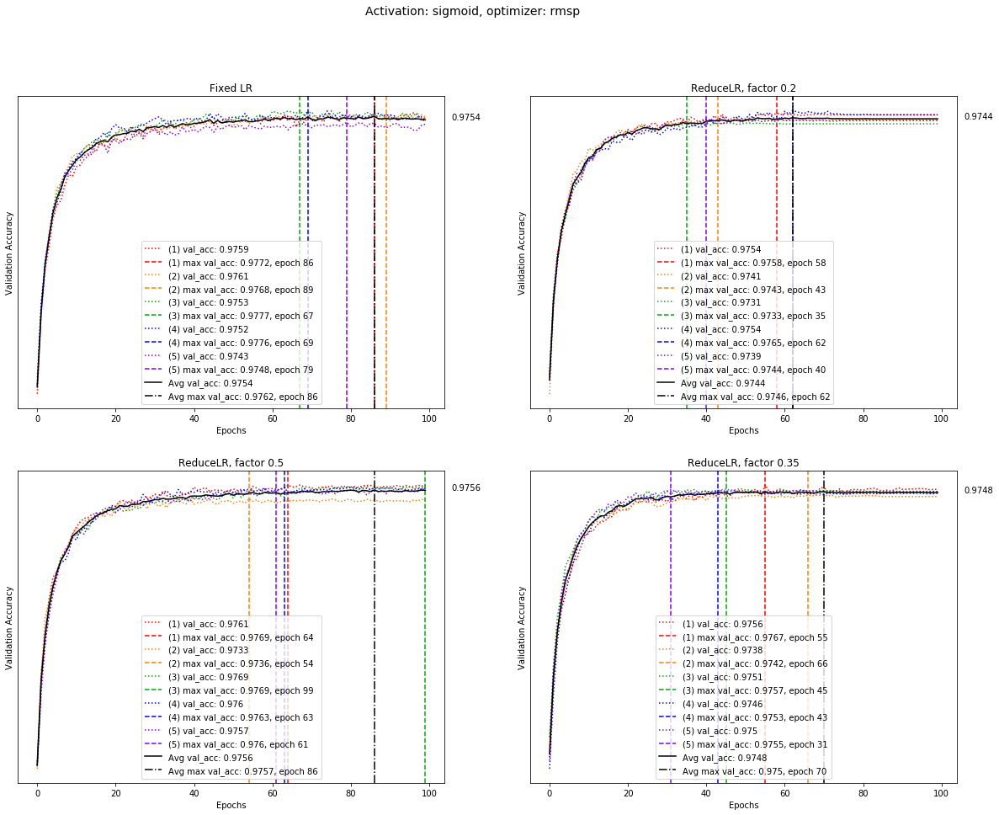

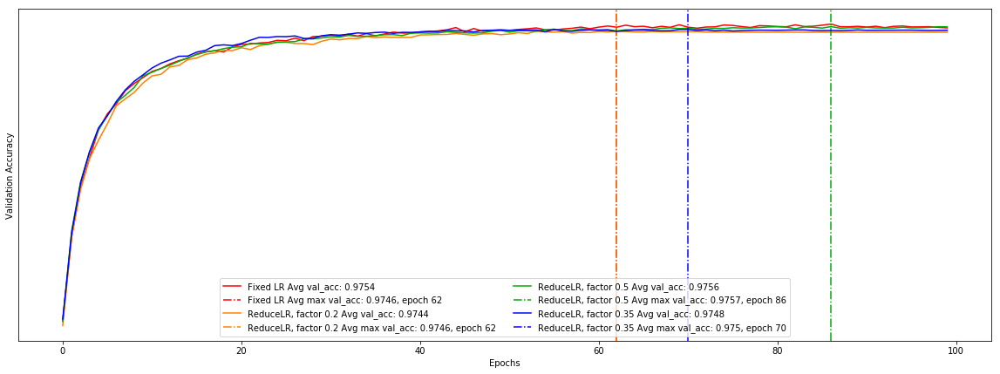

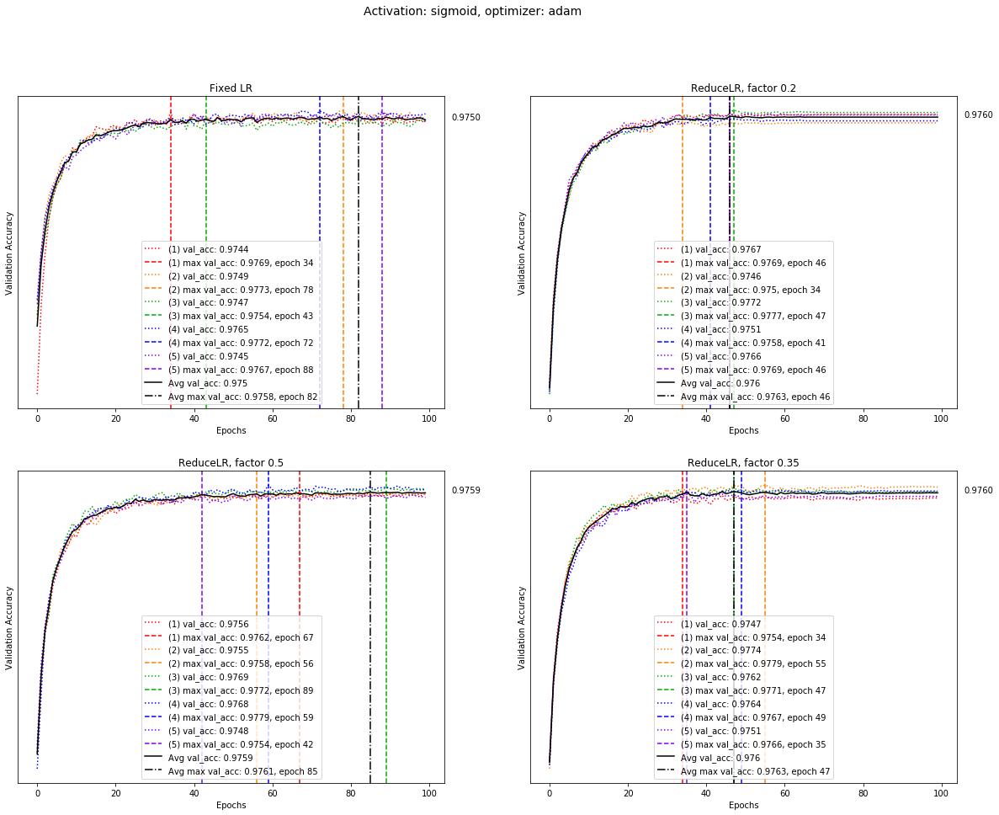

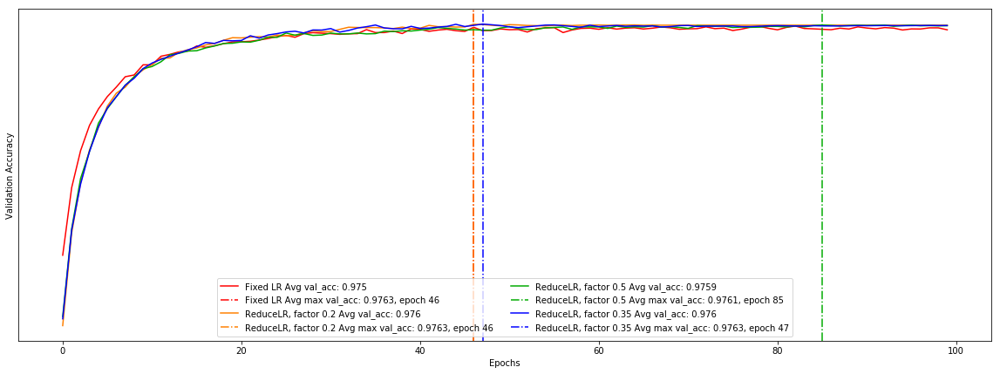

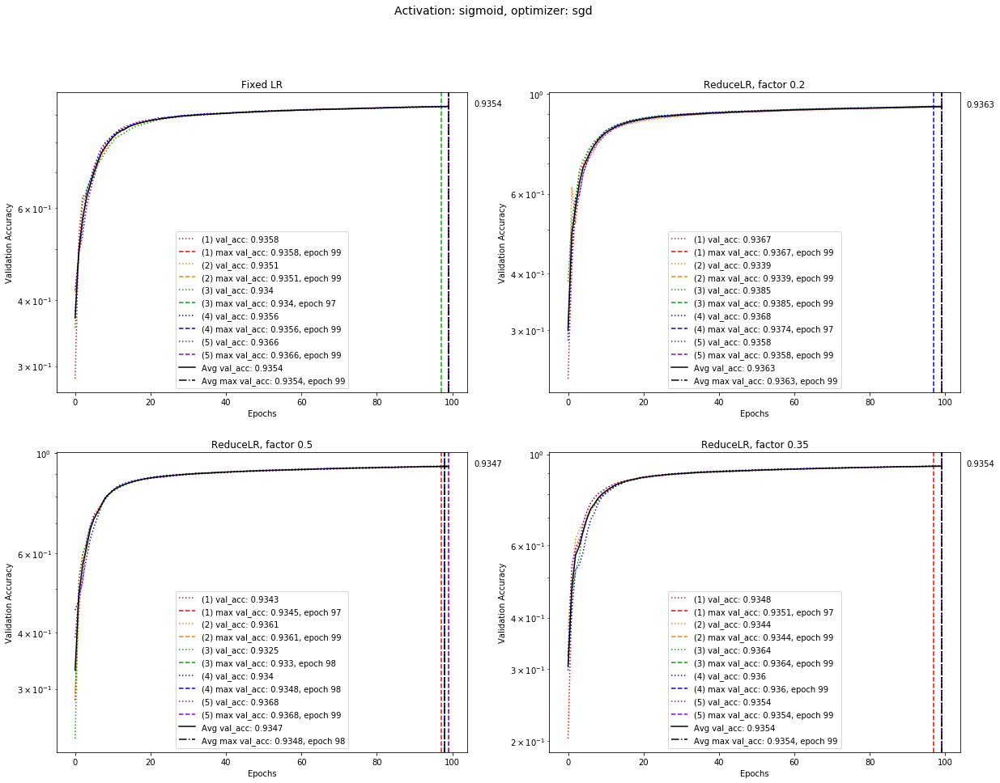

...

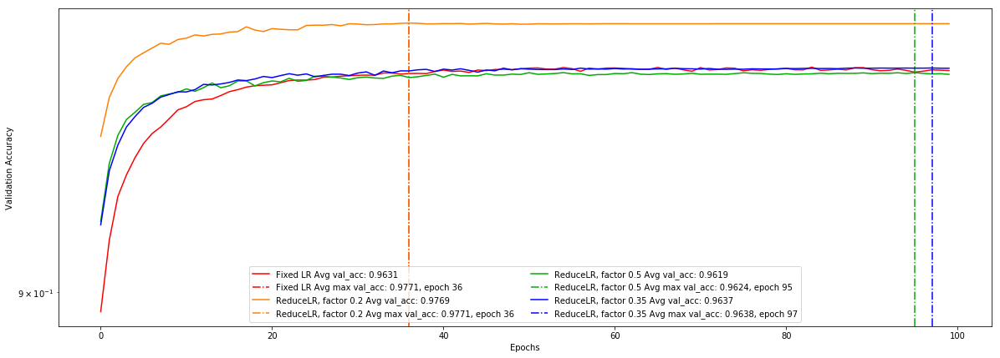

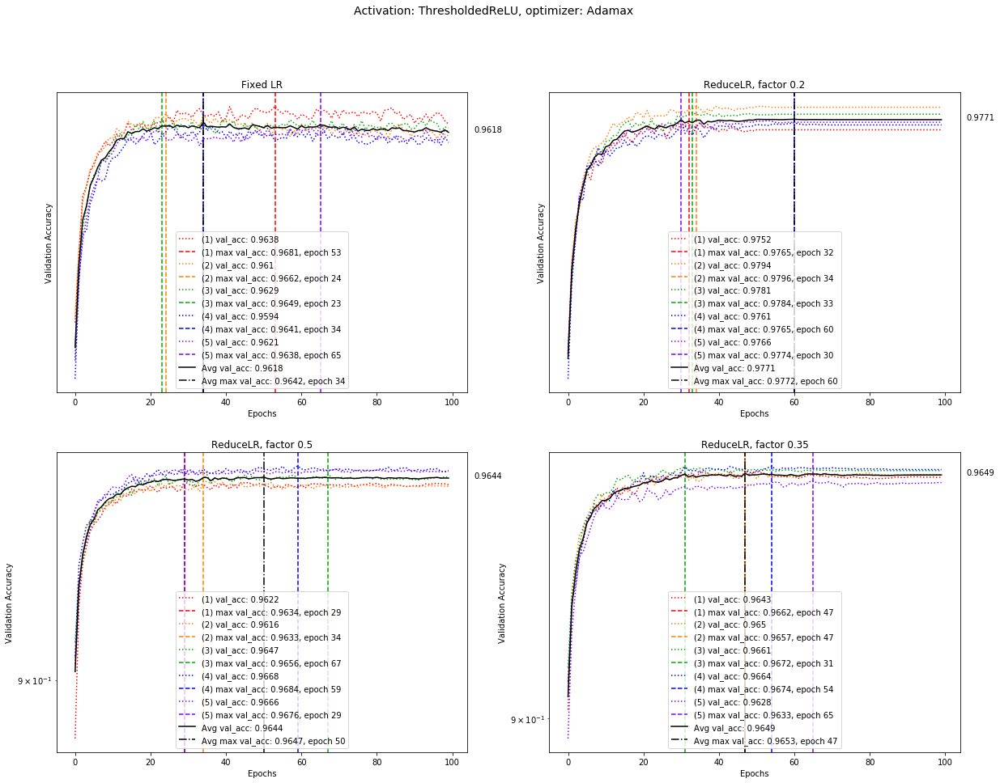

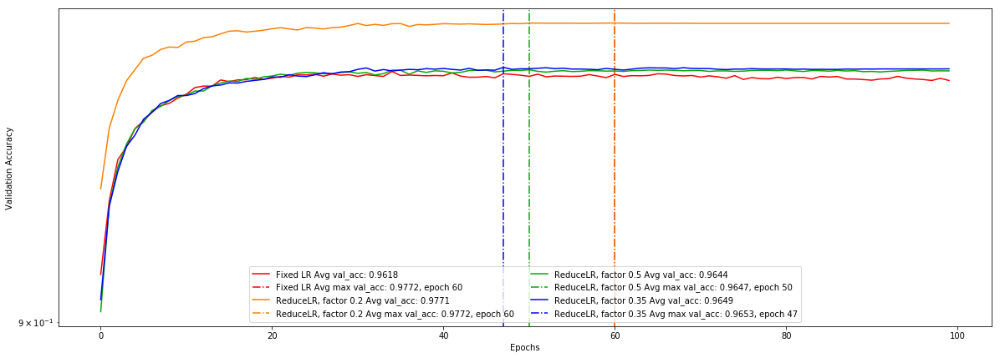

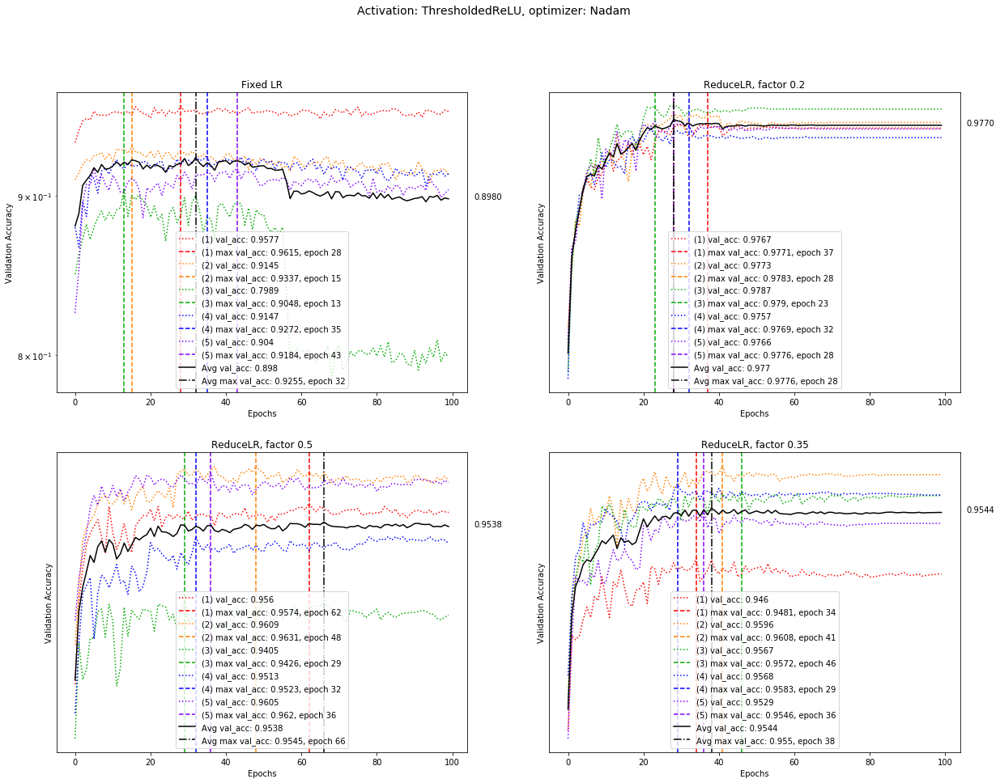

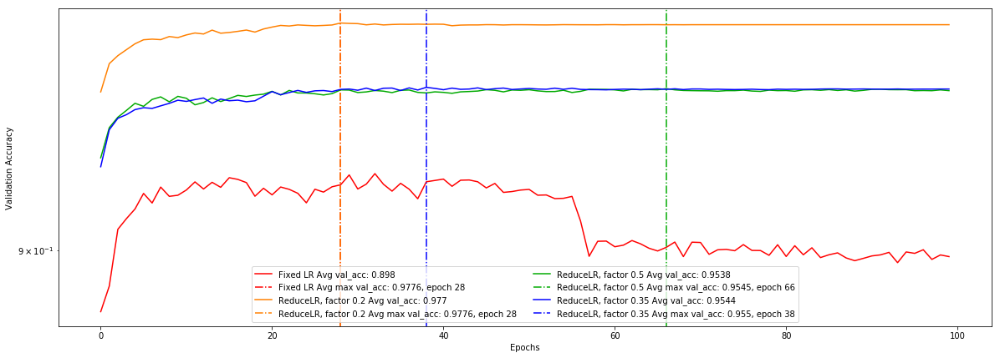

In [99]:
for d in range(len(data_fx)):

    clr = 0
    plt.figure(figsize=(20,15))
    plt.suptitle(data_fx[d]['name'], fontsize=14)
    plt.subplot(2,2,1)

    for i in range(experiments):
        plt.plot(range(epochs),
                 data_fx[d]['data'][i]['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle=':',
                 label='(' + str(i+1) + ') val_acc: ' + str(round(data_fx[d]['data'][i]['val_acc'].tolist()[-1], 4)))
        plt.axvline(x=data_fx[d]['max_val_acc'][i]['epoch'], 
                    label='(' + str(i+1) + ') max val_acc: ' + str(round(data_fx[d]['max_val_acc'][i]['val_acc'], 4)) + ', epoch ' + str(data_fx[d]['max_val_acc'][i]['epoch']),
                   color = colors_new[clr],
                   linestyle='--')
        clr += 1
        if clr > len(colors_new):
            clr = clr % len(colors_new)
    plt.plot(range(epochs),
                 data_fx[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='Avg val_acc: ' + str(round(data_fx[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_fx[d]['max_val_acc']['avg']['epoch'], 
                label='Avg max val_acc: ' + str(round(data_fx[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_fx[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    plt.title('Fixed LR')
    plt.annotate('%0.4f' % data_fx[d]['averaged']['val_acc'].tolist()[-1], 
                 xy=(1, data_fx[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                 xycoords=('axes fraction', 'data'), textcoords='offset points')
    plt.legend(loc='lower center',ncol=1)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
    plt.yscale('log')

    clr = 0
    plt.subplot(2,2,2)
    for i in range(experiments):
        plt.plot(range(epochs),
                 data_02[d]['data'][i]['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle=':',
                 label='(' + str(i+1) + ') val_acc: ' + str(round(data_02[d]['data'][i]['val_acc'].tolist()[-1], 4)))
        plt.axvline(x=data_02[d]['max_val_acc'][i]['epoch'], 
            label='(' + str(i+1) + ') max val_acc: ' + str(round(data_02[d]['max_val_acc'][i]['val_acc'], 4)) + ', epoch ' + str(data_02[d]['max_val_acc'][i]['epoch']),
           color = colors_new[clr],
           linestyle='--')
        clr += 1
        if clr > len(colors_new):
            clr = clr % len(colors_new)
    plt.plot(range(epochs),
                 data_02[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='Avg val_acc: ' + str(round(data_02[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_02[d]['max_val_acc']['avg']['epoch'], 
                label='Avg max val_acc: ' + str(round(data_02[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_02[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    plt.title('ReduceLR, factor 0.2')
    plt.annotate('%0.4f' % data_02[d]['averaged']['val_acc'].tolist()[-1], 
                 xy=(1, data_02[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                 xycoords=('axes fraction', 'data'), textcoords='offset points')
    plt.legend(loc='lower center',ncol=1)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
    plt.yscale('log')
    
    clr = 0
    plt.subplot(2,2,3)
    for i in range(experiments):
        plt.plot(range(epochs),
                 data_05[d]['data'][i]['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle=':',
                 label='(' + str(i+1) + ') val_acc: ' + str(round(data_05[d]['data'][i]['val_acc'].tolist()[-1], 4)))
        plt.axvline(x=data_05[d]['max_val_acc'][i]['epoch'], 
            label='(' + str(i+1) + ') max val_acc: ' + str(round(data_05[d]['max_val_acc'][i]['val_acc'], 4)) + ', epoch ' + str(data_05[d]['max_val_acc'][i]['epoch']),
           color = colors_new[clr],
           linestyle='--')
        clr += 1
        if clr > len(colors_new):
            clr = clr % len(colors_new)
    plt.plot(range(epochs),
                 data_05[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='Avg val_acc: ' + str(round(data_05[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_05[d]['max_val_acc']['avg']['epoch'], 
                label='Avg max val_acc: ' + str(round(data_05[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_05[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    plt.title('ReduceLR, factor 0.5')
    plt.annotate('%0.4f' % data_05[d]['averaged']['val_acc'].tolist()[-1], 
                 xy=(1, data_05[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                 xycoords=('axes fraction', 'data'), textcoords='offset points')
    plt.legend(loc='lower center',ncol=1)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
    plt.yscale('log')
    
    clr = 0
    plt.subplot(2,2,4)
    for i in range(experiments):
        plt.plot(range(epochs),
                 data_035[d]['data'][i]['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle=':',
                 label='(' + str(i+1) + ') val_acc: ' + str(round(data_035[d]['data'][i]['val_acc'].tolist()[-1], 4)))
        plt.axvline(x=data_035[d]['max_val_acc'][i]['epoch'], 
            label='(' + str(i+1) + ') max val_acc: ' + str(round(data_035[d]['max_val_acc'][i]['val_acc'], 4)) + ', epoch ' + str(data_035[d]['max_val_acc'][i]['epoch']),
           color = colors_new[clr],
           linestyle='--')
        clr += 1
        if clr > len(colors_new):
            clr = clr % len(colors_new)
    plt.plot(range(epochs),
                 data_035[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='Avg val_acc: ' + str(round(data_035[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_035[d]['max_val_acc']['avg']['epoch'], 
                label='Avg max val_acc: ' + str(round(data_035[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_035[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    plt.title('ReduceLR, factor 0.35')
    plt.annotate('%0.4f' % data_035[d]['averaged']['val_acc'].tolist()[-1], 
                 xy=(1, data_035[d]['averaged']['val_acc'].tolist()[-1]), xytext=(8, 0), 
                 xycoords=('axes fraction', 'data'), textcoords='offset points')
    plt.legend(loc='lower center',ncol=1)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
    plt.yscale('log')
    
    plt.show()
    
    
    #----------------------
    plt.figure(figsize=(20,7))
    clr = 0
    plt.plot(range(epochs),
                 data_fx[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='Fixed LR Avg val_acc: ' + str(round(data_fx[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_fx[d]['max_val_acc']['avg']['epoch'], 
                label='Fixed LR Avg max val_acc: ' + str(round(data_fx[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_fx[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    clr += 1
    
    plt.plot(range(epochs),
                 data_02[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='ReduceLR, factor 0.2 Avg val_acc: ' + str(round(data_02[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_02[d]['max_val_acc']['avg']['epoch'], 
                label='ReduceLR, factor 0.2 Avg max val_acc: ' + str(round(data_02[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_02[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    clr += 1
    
    plt.plot(range(epochs),
                 data_05[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='ReduceLR, factor 0.5 Avg val_acc: ' + str(round(data_05[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_05[d]['max_val_acc']['avg']['epoch'], 
                label='ReduceLR, factor 0.5 Avg max val_acc: ' + str(round(data_05[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_05[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    clr += 1
    
    plt.plot(range(epochs),
                 data_035[d]['averaged']['val_acc'].tolist(),
                 colors_new[clr],
                 linestyle='-',
                 label='ReduceLR, factor 0.35 Avg val_acc: ' + str(round(data_035[d]['averaged']['val_acc'].tolist()[-1], 4)))
    plt.axvline(x=data_035[d]['max_val_acc']['avg']['epoch'], 
                label='ReduceLR, factor 0.35 Avg max val_acc: ' + str(round(data_035[d]['max_val_acc']['avg']['val_acc'], 4)) + ', epoch ' + str(data_035[d]['max_val_acc']['avg']['epoch']),
                color = colors_new[clr],                   
                linestyle='-.')
    
    plt.legend(loc='lower center',ncol=2)
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
    plt.yscale('log')
    
    plt.show()

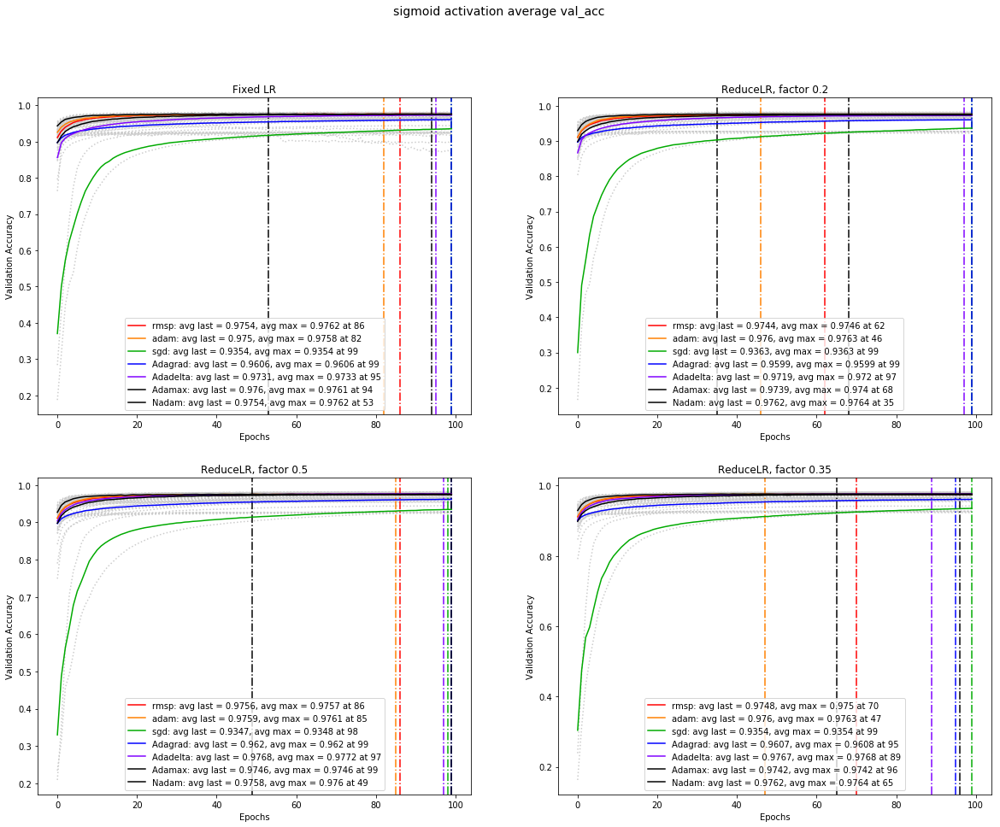

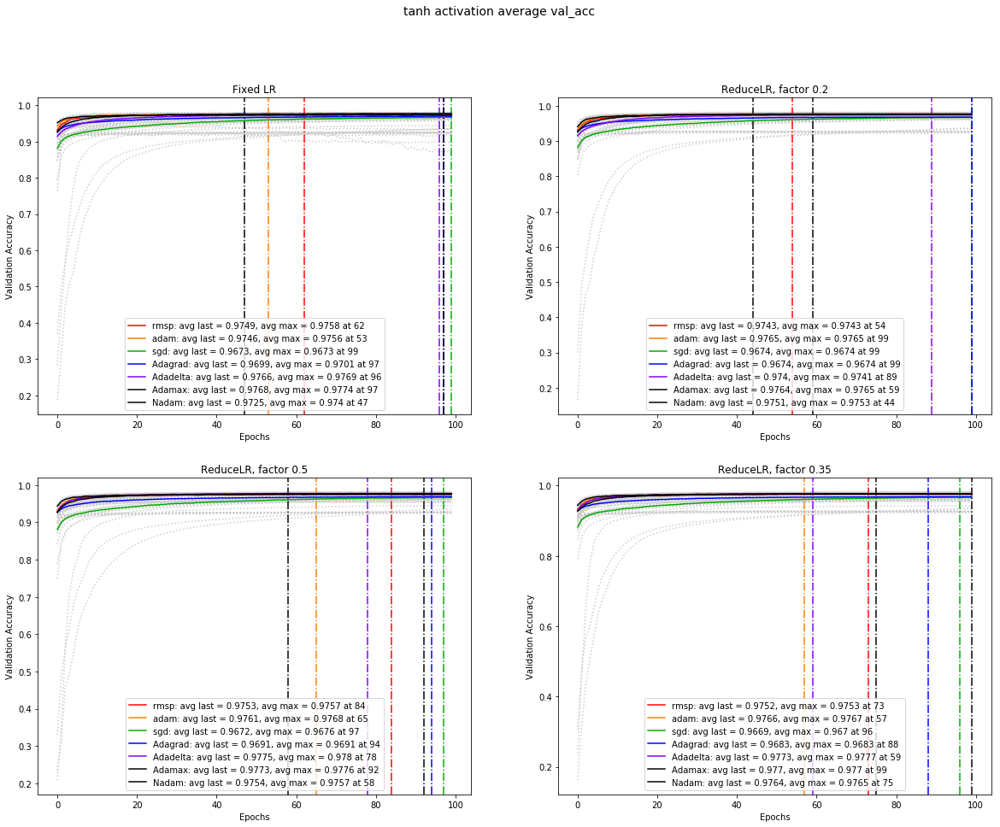

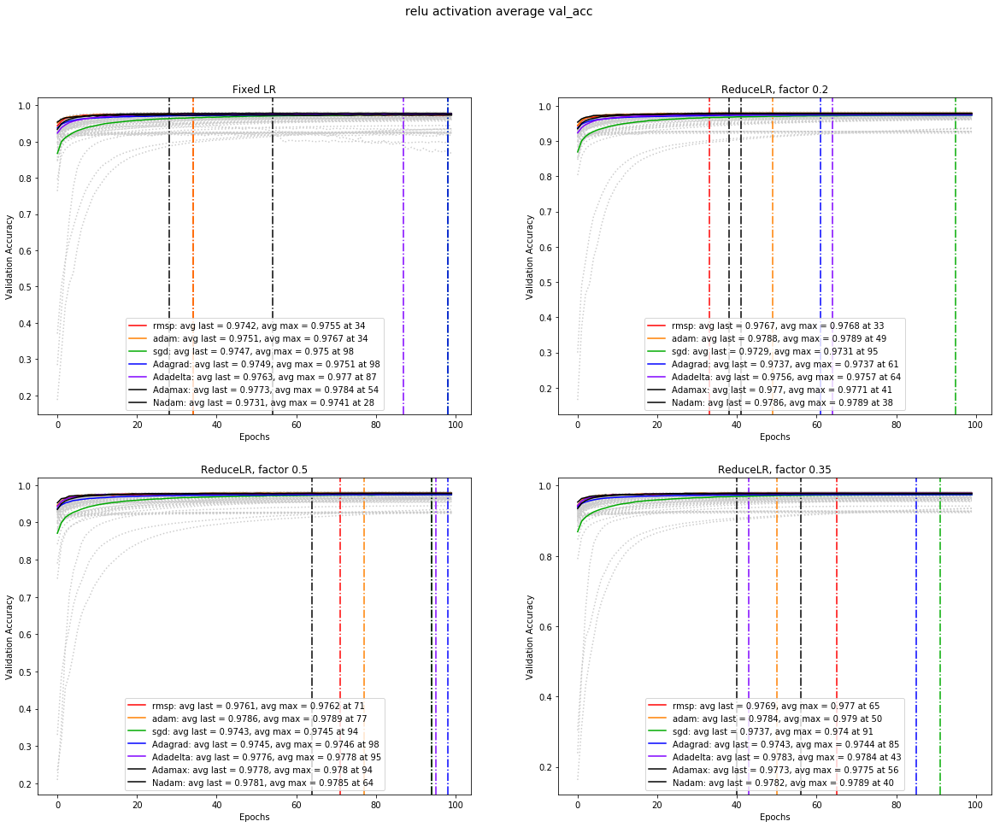

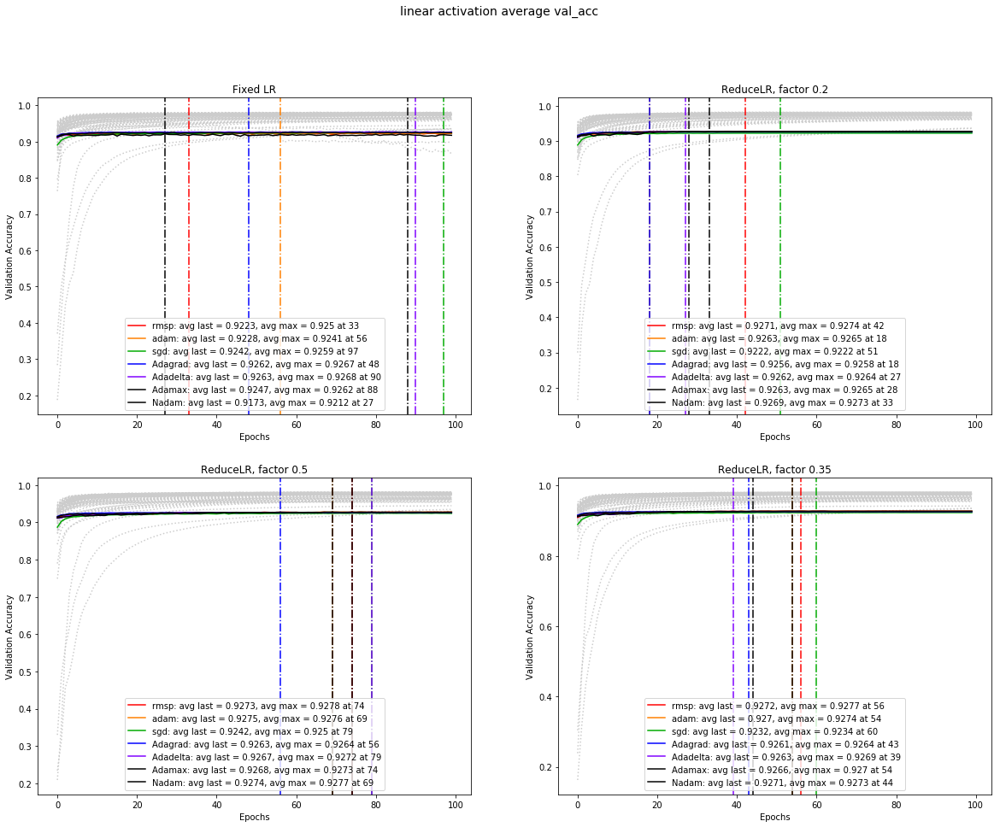

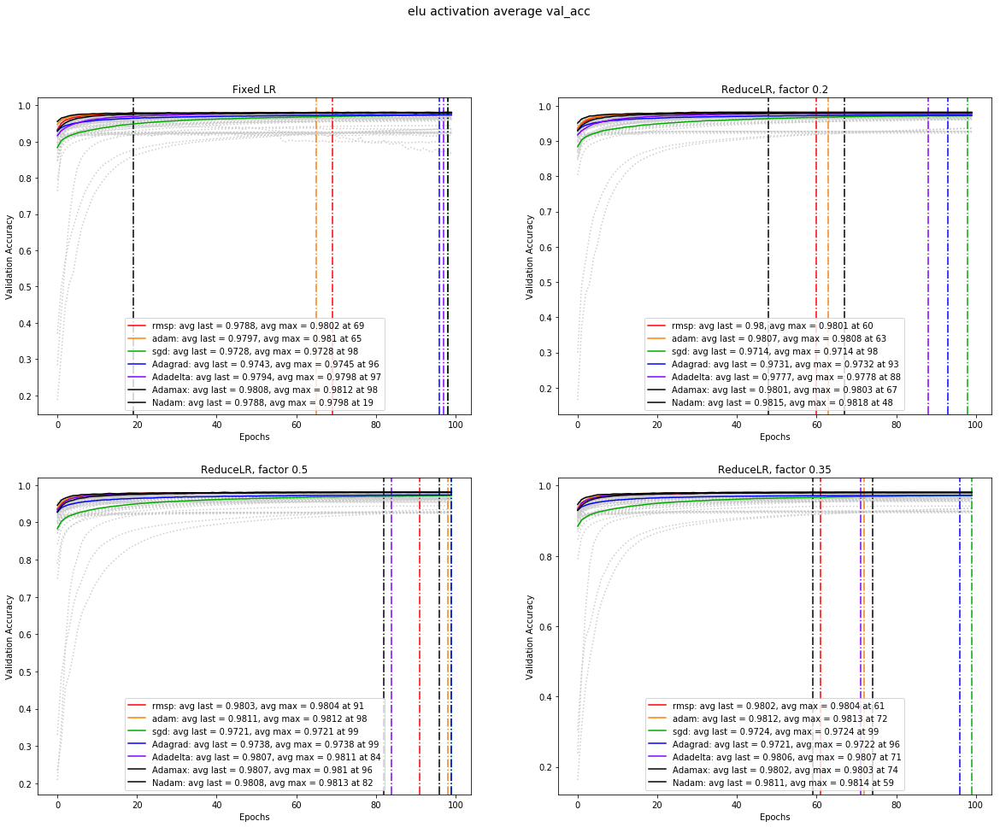

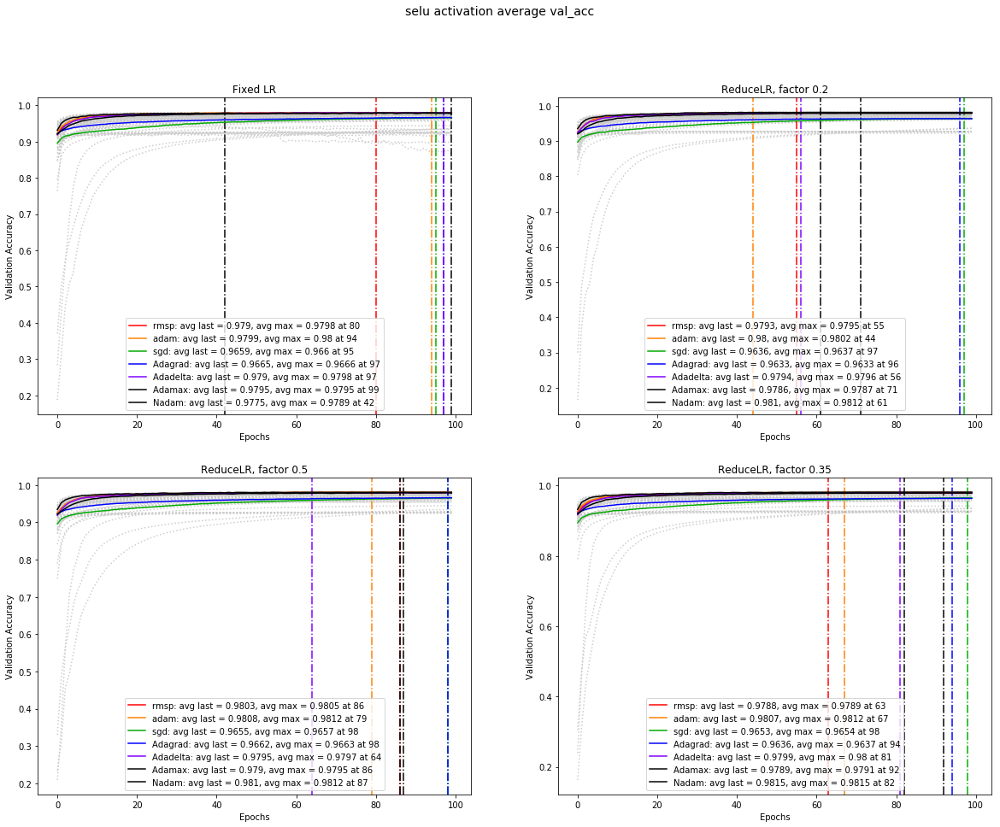

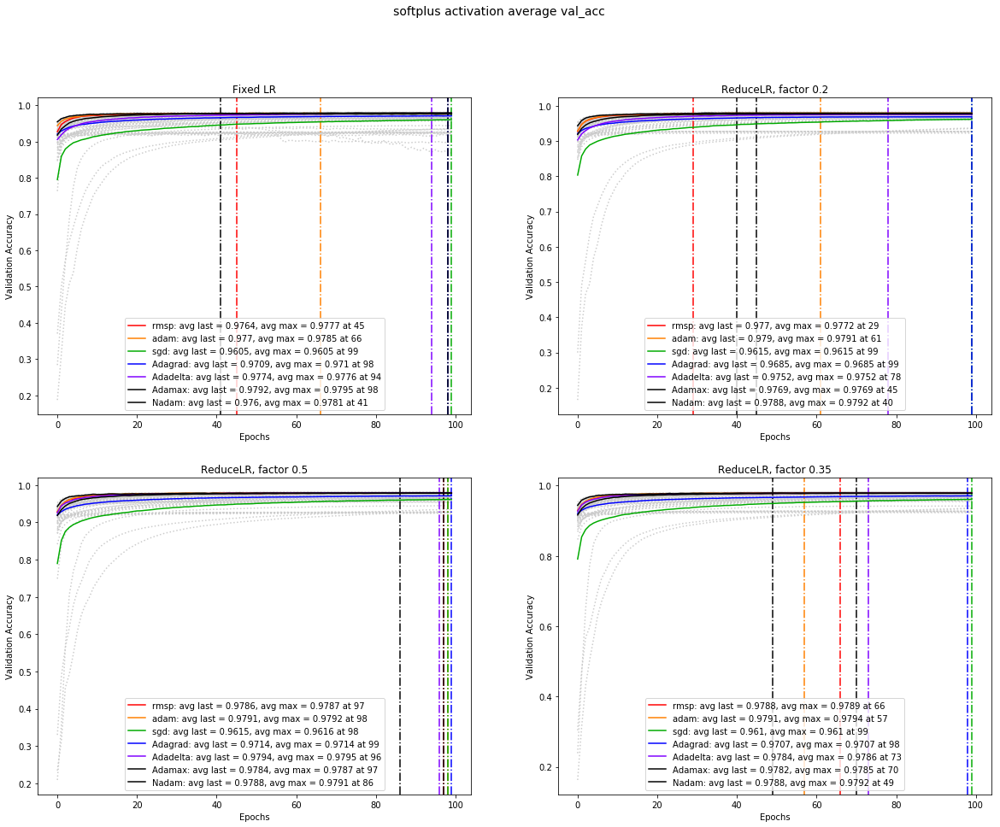

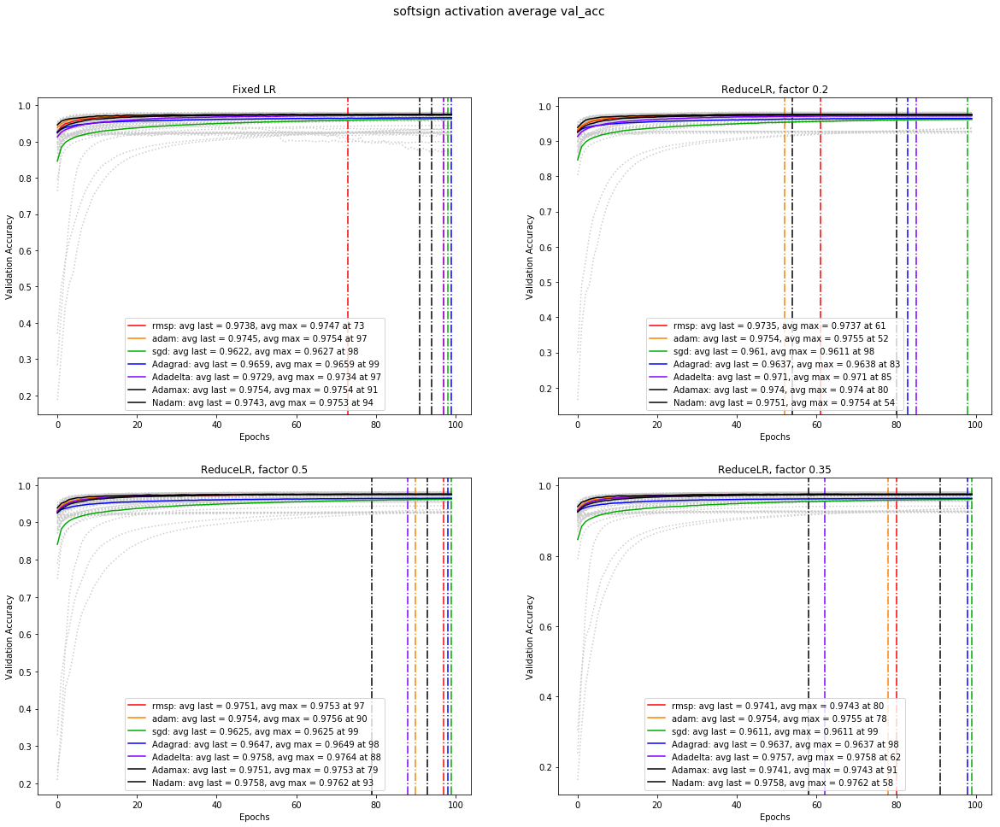

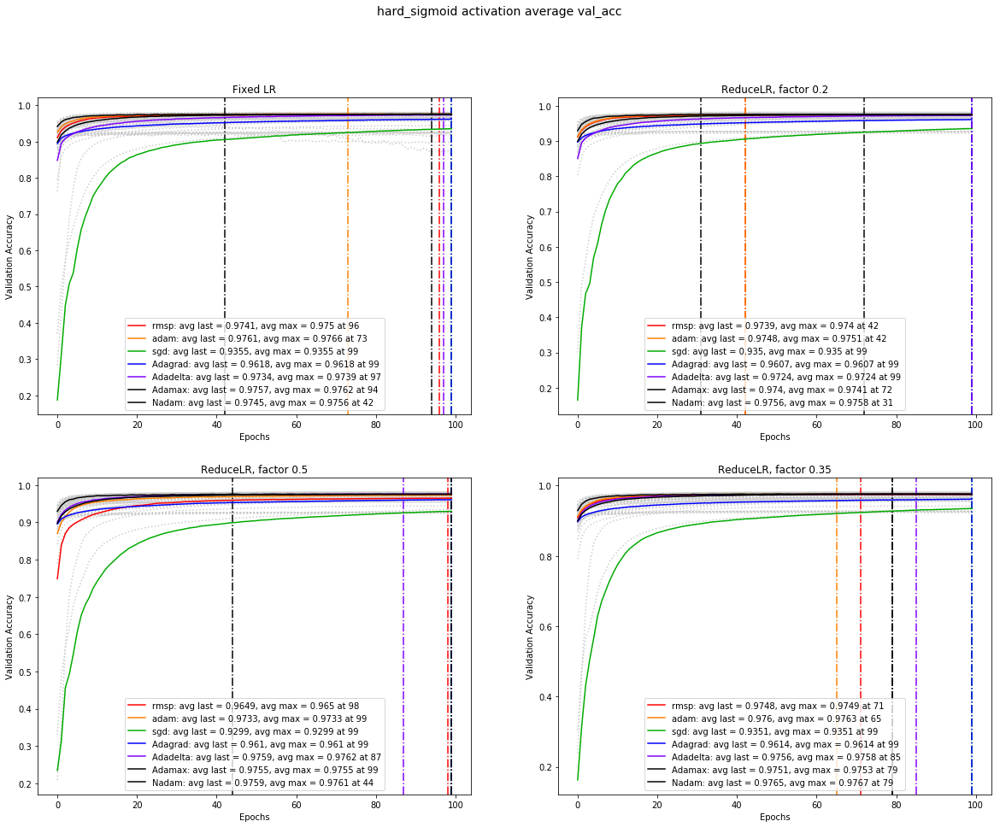

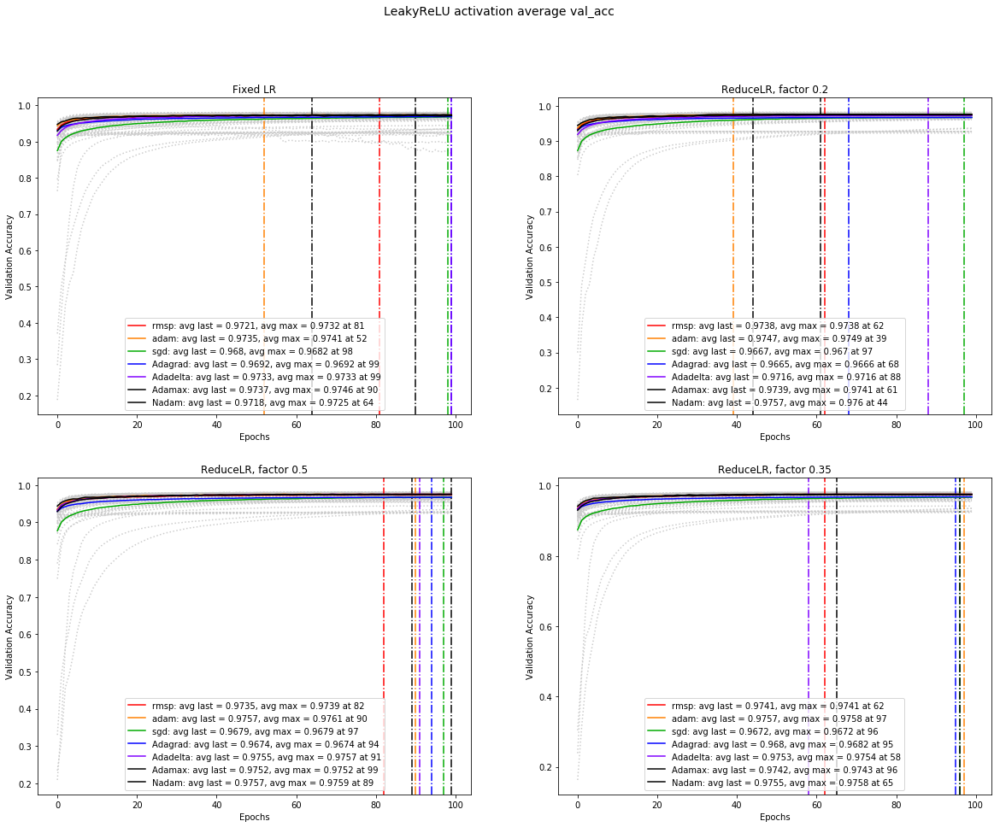

In [100]:
clr = 0
for act in activations:

    plt.figure(figsize=(20,15))
    plt.suptitle(act + ' activation average val_acc', fontsize=14)
    
    plt.subplot(2,2,1)
    for d in data_fx:
        if d['act'] != act:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     '#CCCCCC',
                     linestyle=':', 
                    zorder = 0)
        else:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     colors_new[clr % len(colors_new)],
                     linestyle='-',
                     label=d['opt'] + ': avg last = ' + str(round(d['averaged']['val_acc'].tolist()[-1], 4)) + 
                             ', avg max = ' + str(round(d['max_val_acc']['avg']['val_acc'], 4)) + ' at ' 
                             + str(d['max_val_acc']['avg']['epoch']),
                    zorder = 10)
            plt.axvline(x=d['max_val_acc']['avg']['epoch'], 
                color = colors_new[clr % len(colors_new)],                   
                linestyle='-.')
            clr+=1
            
    plt.title('Fixed LR')

    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    plt.legend(loc='lower center',ncol=1)

    
    plt.subplot(2,2,2)
    for d in data_02:
        if d['act'] != act:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     '#CCCCCC',
                     linestyle=':', 
                    zorder = 0)
        else:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     colors_new[clr % len(colors_new)],
                     linestyle='-',
                     label=d['opt'] + ': avg last = ' + str(round(d['averaged']['val_acc'].tolist()[-1], 4)) + 
                             ', avg max = ' + str(round(d['max_val_acc']['avg']['val_acc'], 4)) + ' at ' 
                             + str(d['max_val_acc']['avg']['epoch']),
                    zorder = 10)
            plt.axvline(x=d['max_val_acc']['avg']['epoch'], 
                color = colors_new[clr % len(colors_new)],                   
                linestyle='-.')
            clr+=1
            
    plt.title('ReduceLR, factor 0.2')

    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    plt.legend(loc='lower center',ncol=1)
    
    plt.subplot(2,2,3)
    for d in data_05:
        if d['act'] != act:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     '#CCCCCC',
                     linestyle=':', 
                    zorder = 0)
        else:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     colors_new[clr % len(colors_new)],
                     linestyle='-',
                     label=d['opt'] + ': avg last = ' + str(round(d['averaged']['val_acc'].tolist()[-1], 4)) + 
                             ', avg max = ' + str(round(d['max_val_acc']['avg']['val_acc'], 4)) + ' at ' 
                             + str(d['max_val_acc']['avg']['epoch']),
                    zorder = 10)
            plt.axvline(x=d['max_val_acc']['avg']['epoch'], 
                color = colors_new[clr % len(colors_new)],                   
                linestyle='-.')
            clr+=1
            
    plt.title('ReduceLR, factor 0.5')
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    plt.legend(loc='lower center',ncol=1)

    
    plt.subplot(2,2,4)
    for d in data_035:
        if d['act'] != act:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     '#CCCCCC',
                     linestyle=':', 
                    zorder = 0)
        else:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     colors_new[clr % len(colors_new)],
                     linestyle='-',
                     label=d['opt'] + ': avg last = ' + str(round(d['averaged']['val_acc'].tolist()[-1], 4)) + 
                             ', avg max = ' + str(round(d['max_val_acc']['avg']['val_acc'], 4)) + ' at ' 
                             + str(d['max_val_acc']['avg']['epoch']),
                    zorder = 10)
            plt.axvline(x=d['max_val_acc']['avg']['epoch'], 
                color = colors_new[clr % len(colors_new)],                   
                linestyle='-.')
            clr+=1
            
    plt.title('ReduceLR, factor 0.35')
    
    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    plt.legend(loc='lower center',ncol=1)
    plt.show()

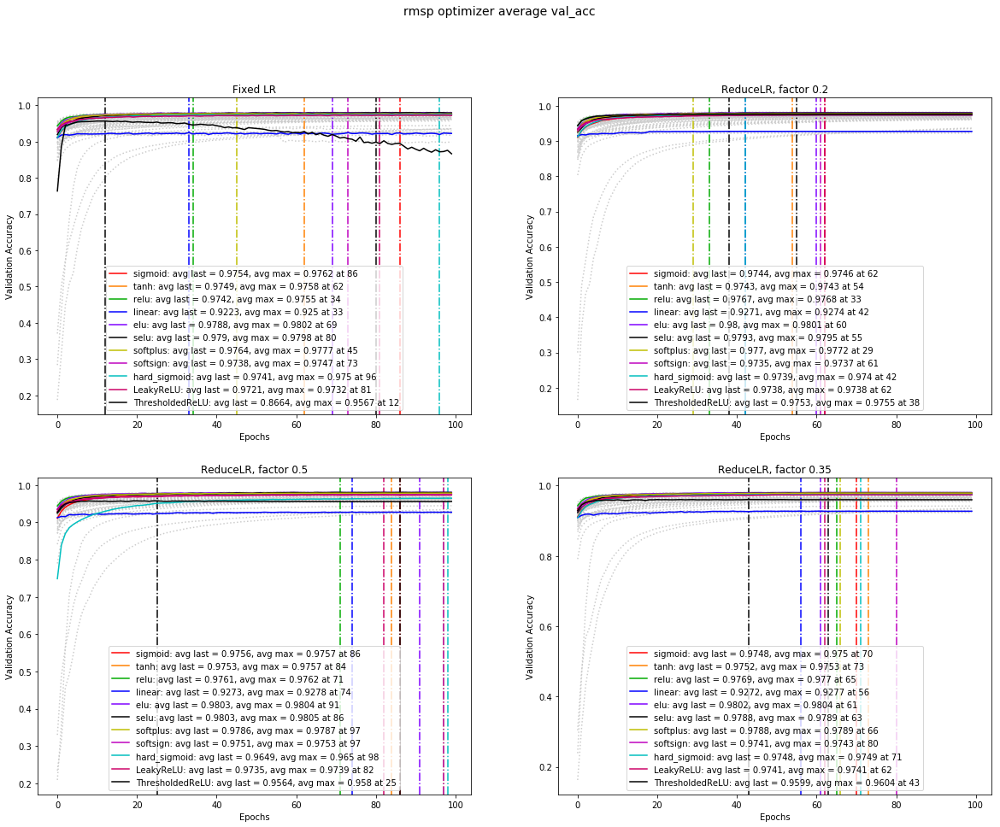

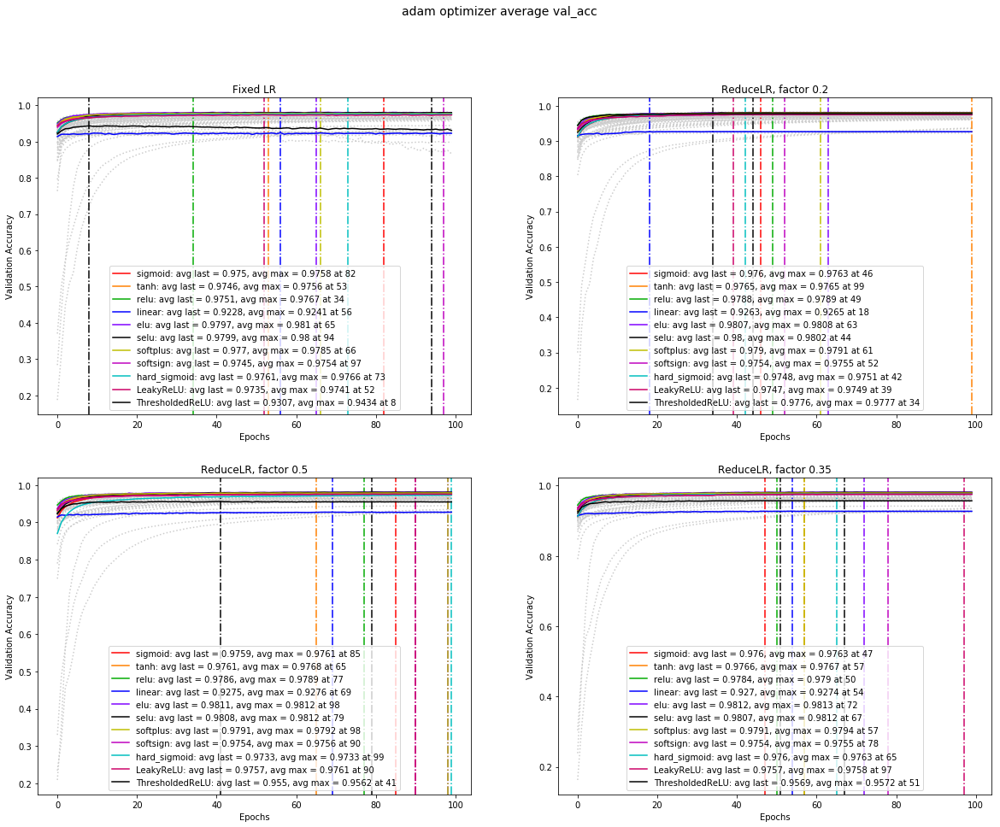

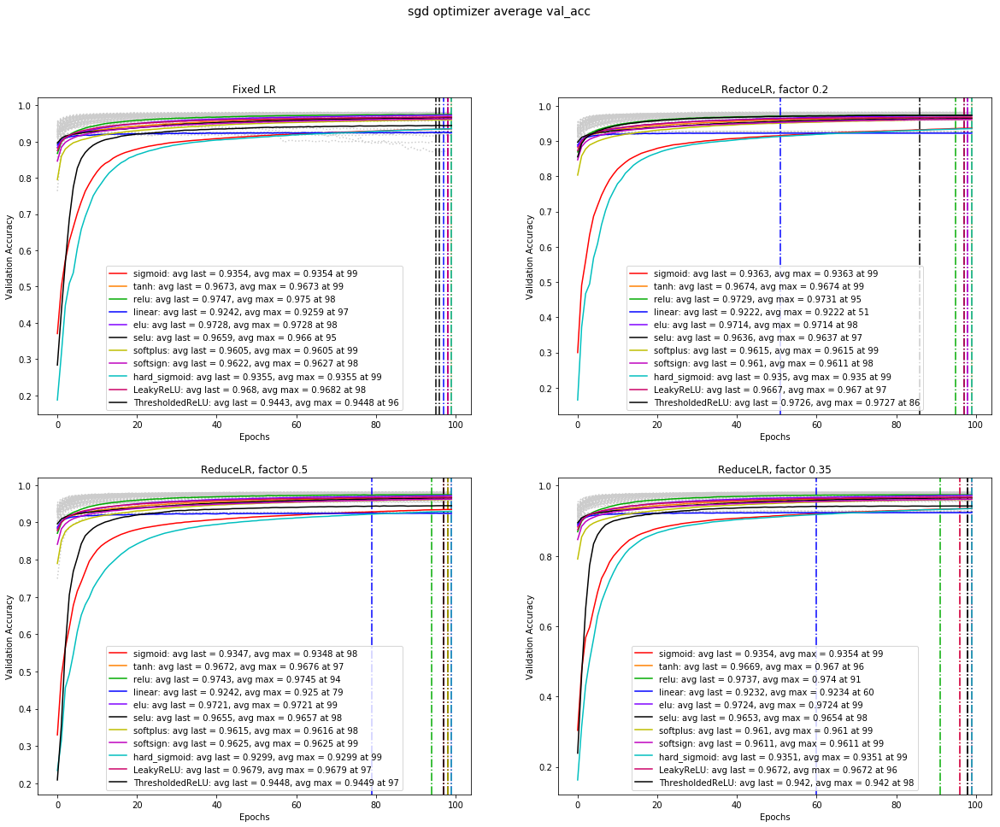

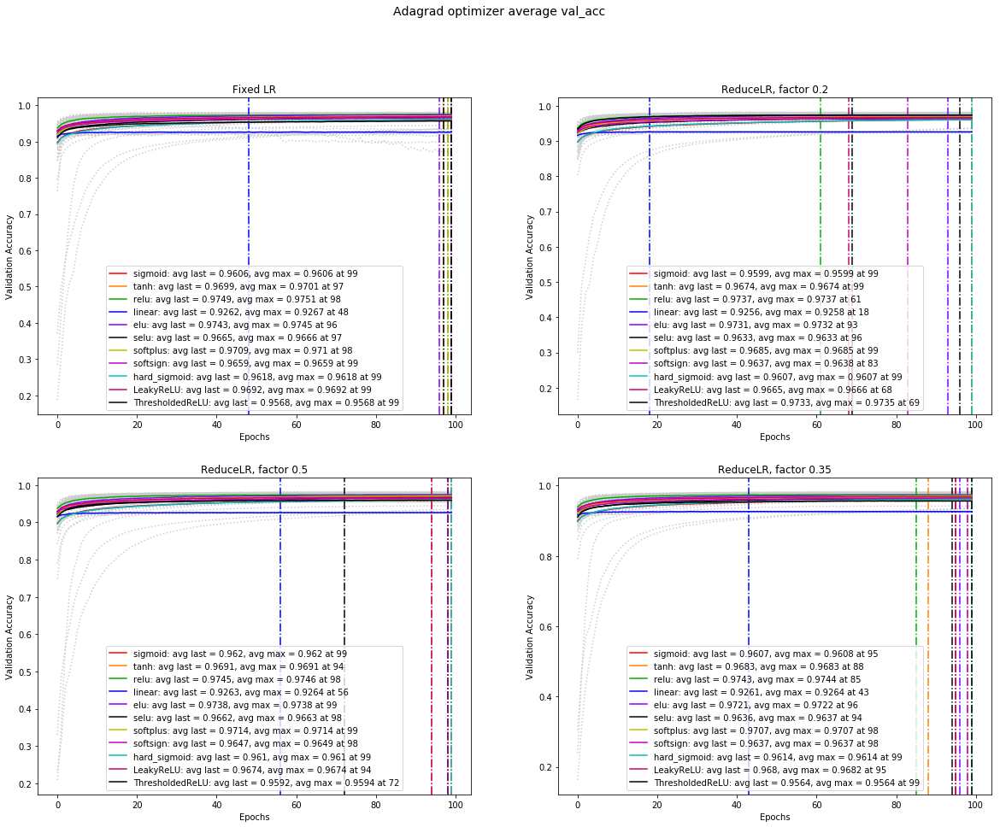

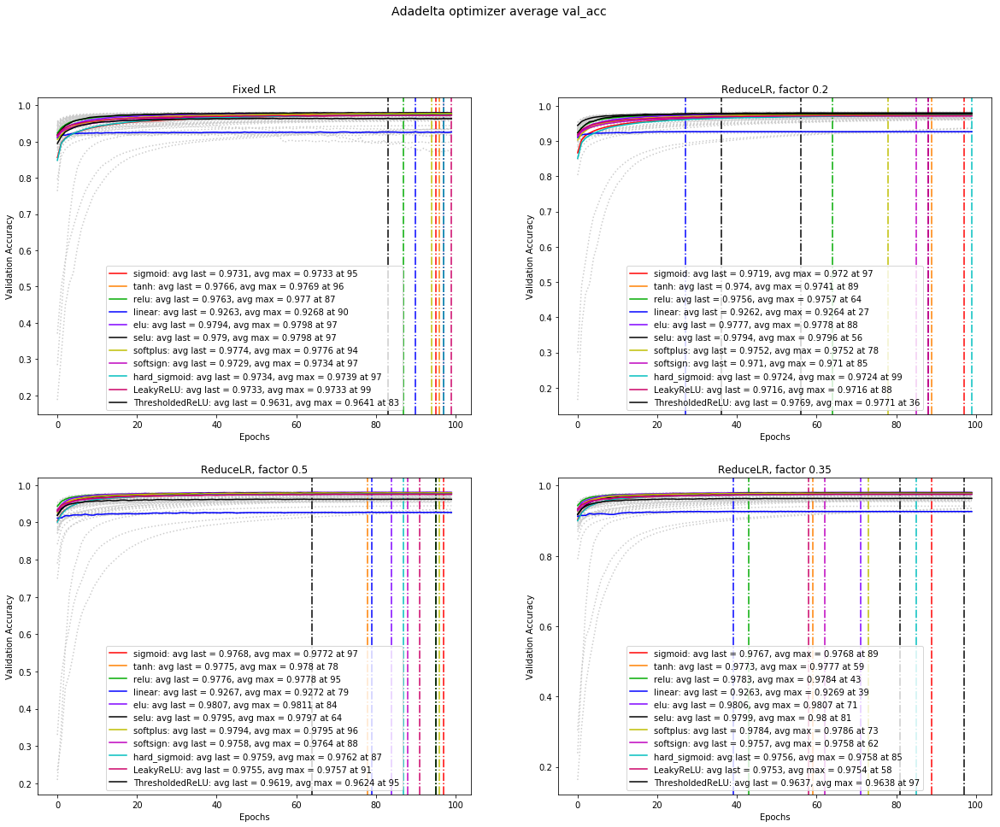

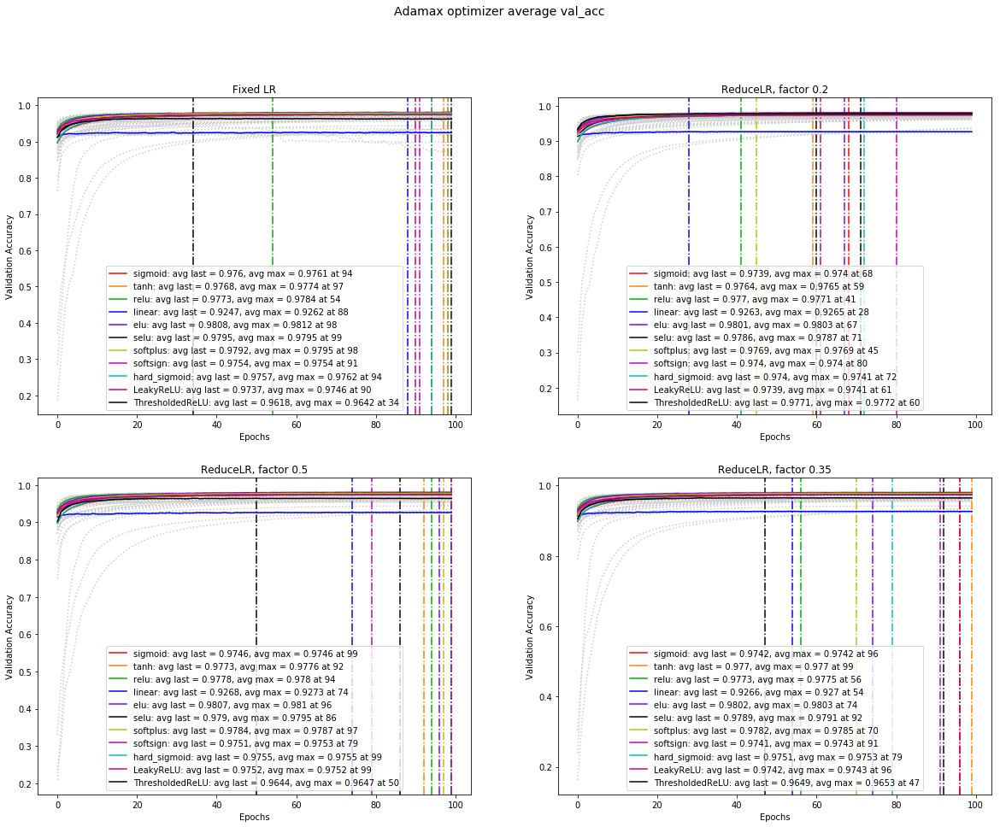

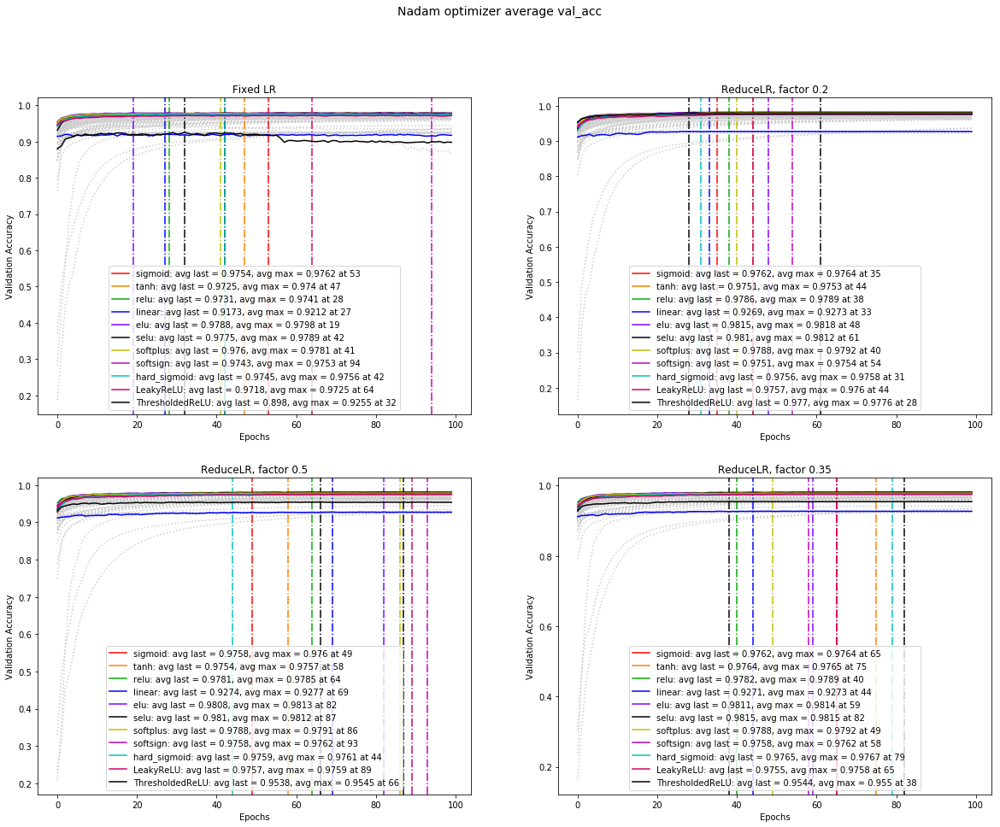

In [101]:
clr = 0
for opt in optimizers:

    plt.figure(figsize=(20,15))
    plt.suptitle(opt + ' optimizer average val_acc', fontsize=14)
    
    plt.subplot(2,2,1)
    for d in data_fx:
        if d['opt'] != opt:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     '#CCCCCC',
                     linestyle=':', 
                    zorder = 0)
        else:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     colors_opt[clr % len(colors_opt)],
                     linestyle='-',
                     label=d['act'] + ': avg last = ' + str(round(d['averaged']['val_acc'].tolist()[-1], 4)) + 
                             ', avg max = ' + str(round(d['max_val_acc']['avg']['val_acc'], 4)) + ' at ' 
                             + str(d['max_val_acc']['avg']['epoch']),
                    zorder = 10)
            plt.axvline(x=d['max_val_acc']['avg']['epoch'], 
                color = colors_opt[clr % len(colors_opt)],                   
                linestyle='-.')
            clr+=1
            
    plt.title('Fixed LR')

    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    plt.legend(loc='lower center',ncol=1)

    
    plt.subplot(2,2,2)
    for d in data_02:
        if d['opt'] != opt:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     '#CCCCCC',
                     linestyle=':', 
                    zorder = 0)
        else:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     colors_opt[clr % len(colors_opt)],
                     linestyle='-',
                     label=d['act'] + ': avg last = ' + str(round(d['averaged']['val_acc'].tolist()[-1], 4)) + 
                             ', avg max = ' + str(round(d['max_val_acc']['avg']['val_acc'], 4)) + ' at ' 
                             + str(d['max_val_acc']['avg']['epoch']),
                    zorder = 10)
            plt.axvline(x=d['max_val_acc']['avg']['epoch'], 
                color = colors_opt[clr % len(colors_opt)],                   
                linestyle='-.')
            clr+=1
            
    plt.title('ReduceLR, factor 0.2')

    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    plt.legend(loc='lower center',ncol=1)
    
    plt.subplot(2,2,3)
    for d in data_05:
        if d['opt'] != opt:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     '#CCCCCC',
                     linestyle=':', 
                    zorder = 0)
        else:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     colors_opt[clr % len(colors_opt)],
                     linestyle='-',
                     label=d['act'] + ': avg last = ' + str(round(d['averaged']['val_acc'].tolist()[-1], 4)) + 
                             ', avg max = ' + str(round(d['max_val_acc']['avg']['val_acc'], 4)) + ' at ' 
                             + str(d['max_val_acc']['avg']['epoch']),
                    zorder = 10)
            plt.axvline(x=d['max_val_acc']['avg']['epoch'], 
                color = colors_opt[clr % len(colors_opt)],                   
                linestyle='-.')
            clr+=1
            
    plt.title('ReduceLR, factor 0.5')

    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    plt.legend(loc='lower center',ncol=1)
    
    plt.subplot(2,2,4)
    for d in data_035:
        if d['opt'] != opt:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     '#CCCCCC',
                     linestyle=':', 
                    zorder = 0)
        else:
            plt.plot(range(epochs),
                     d['averaged']['val_acc'].tolist(),
                     colors_opt[clr % len(colors_opt)],
                     linestyle='-',
                     label=d['act'] + ': avg last = ' + str(round(d['averaged']['val_acc'].tolist()[-1], 4)) + 
                             ', avg max = ' + str(round(d['max_val_acc']['avg']['val_acc'], 4)) + ' at ' 
                             + str(d['max_val_acc']['avg']['epoch']),
                    zorder = 10)
            plt.axvline(x=d['max_val_acc']['avg']['epoch'], 
                color = colors_opt[clr % len(colors_opt)],                   
                linestyle='-.')
            clr+=1
            
    plt.title('ReduceLR, factor 0.35')

    plt.xlabel('Epochs')
    plt.ylabel('Validation Accuracy')
#     plt.yscale('log')
    plt.legend(loc='lower center',ncol=1)
    
    plt.show()

In [102]:
sorted_by_val_acc = results.sort_values(by=['Last Average val_acc Diff (0.35 - Fix)'], ascending=False)
sorted_by_val_acc

,opt,act,Fixed LR: Last Average val_acc,ReduceLR (0.2): Last Average val_acc,ReduceLR (0.5): Last Average val_acc,ReduceLR (0.35): Last Average val_acc,Last Average val_acc Diff (0.2 - Fix),Last Average val_acc Diff (0.5 - Fix),Last Average val_acc Diff (0.35 - Fix),Fixed LR: Max Average val_acc,...,Max Last val_acc Diff (0.2 - Fix),Max Last val_acc Diff (0.5 - Fix),Max Last val_acc Diff (0.35 - Fix),Fixed LR: Max Achieved val_acc,ReduceLR (0.2): Max Achieved val_acc,ReduceLR (0.5): Max Achieved val_acc,ReduceLR (0.35): Max Achieved val_acc,Max Achieved val_acc Diff (0.2 - Fix),Max Achieved val_acc Diff (0.5 - Fix),Max Achieved val_acc Diff (0.35 - Fix)
70,rmsp,ThresholdedReLU,86.636,97.532,95.638,95.986,10.896,9.002,9.350,95.666,...,8.52,6.86,7.08,96.22,97.73,96.34,96.36,1.51,0.12,0.14
76,Nadam,ThresholdedReLU,89.796,97.700,95.384,95.440,7.904,5.588,5.644,92.548,...,2.10,0.32,0.19,96.15,97.90,96.31,96.08,1.75,0.16,-0.07
71,adam,ThresholdedReLU,93.070,97.756,95.500,95.690,4.686,2.430,2.620,94.338,...,2.35,0.38,0.73,95.98,97.91,96.13,96.33,1.93,0.15,0.35
27,Nadam,linear,91.730,92.692,92.738,92.706,0.962,1.008,0.976,92.120,...,0.64,0.69,0.61,92.44,92.86,92.89,92.82,0.42,0.45,0.38
20,Nadam,relu,97.308,97.858,97.814,97.820,0.550,0.506,0.512,97.410,...,0.43,0.34,0.29,97.69,98.08,98.04,97.95,0.39,0.35,0.26
21,rmsp,linear,92.234,92.714,92.734,92.722,0.480,0.500,0.488,92.496,...,0.36,0.35,0.34,92.76,92.83,92.89,92.88,0.07,0.13,0.12
22,adam,linear,92.284,92.634,92.754,92.702,0.350,0.470,0.418,92.414,...,0.07,0.18,0.14,92.73,92.75,92.93,92.86,0.02,0.20,0.13
41,Nadam,selu,97.754,98.102,98.096,98.152,0.348,0.342,0.398,97.890,...,0.36,0.32,0.41,98.10,98.24,98.22,98.27,0.14,0.12,0.17
13,Nadam,tanh,97.254,97.512,97.540,97.642,0.258,0.286,0.388,97.398,...,0.24,0.30,0.44,97.60,97.61,97.75,97.82,0.01,0.15,0.22
69,Nadam,LeakyReLU,97.178,97.572,97.572,97.546,0.394,0.394,0.368,97.250,...,0.50,0.40,0.35,97.50,97.82,97.70,97.67,0.32,0.20,0.17


In [41]:
sorted_by_val_acc.to_csv('./results_reduce_lr_0.35.csv')